## shNfkb1-all lanes
12/15/25 - Data generated from shNfkb1 single hairpin experiments; Library included in alignment; data submitted by Jason/Carleigh/Hannah on 5/23 and 5/25/2023
Run on 2 lanes(lane1, lane2)

Analyze global run on cellranger v6 data and create h5_ad files for further analysis

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import pickle

import math
import matplotlib
from matplotlib import pyplot as plt

from pathlib import Path
import anndata

In [2]:
plt.rcParams['svg.fonttype'] = 'none'
plt.rcParams["font.family"] = "Arial"

In [3]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')
np.random.seed(1573)   #fix so we can reproduce later

In [4]:
Path("./figures").mkdir(parents=True, exist_ok=True) # generate figures here
Path("./write").mkdir(parents=True, exist_ok=True) # write h5ad here

In [5]:
results_file = 'write/Nfkb_analysis_all_lanes.h5ad'  # the file that will store the analysis results

In [6]:
library = ["1659-Fosl2.226","1660-Fosl2.752","1661-Fhl2.467","1662-Fhl2.179","1663-Myc.989","1664-Myc.1389","1665-Yap1.735","1666-Yap1.2847","1667-Atf4.1383","1668-Atf4.536","1669-Maff.85","1670-Maff.587","1671-Nfkb2.152","1672-Nfkb2.534","1673-Relb.286","1674-Relb.1795","1675-Onecut2.1799","1676-Onecut2.2361","1810-Slc4a11.541","1934-Slc4a11.1966","1811-Itga2.672","1812-Itga2.204","1998-Cldn4-1013","1999-Cldn4-951","2113-Lif.440","2114-Lif.1890","2115-Fosl1.1401","2116-Fosl1.699","2117-Nfkb1.2331","2118-Nfkb1.3737","shRenilla",'JCP628-shIkbkg-1.2526','JCP629-shIkbkg-2.2984',
           'JCP618-shRela-1.1202','JCP621-shRela-4.1182','JCP623-shRel-1.1868',
           'JCP625-shRel-3.342','Ikbsr-FLAG',]

In [7]:
adata_A = sc.read_h5ad('../JC2434/write/JC2434-allmice-tumor.h5ad')
adata_B = sc.read_h5ad('../JC2438/write/JC2438-allmice-tumor.h5ad')
adata_C = sc.read_h5ad('../IGO15770/write/IGO15770-allmice-tumor.h5ad')
adata_D = sc.read_h5ad('../JC2499/write/JC2499_allmice-tumor.h5ad')

In [8]:
adatas = [adata_A, adata_B, adata_C, adata_D]

In [9]:
samples = set(adata_A.obs.Classification.value_counts().index) | set(adata_B.obs.Classification.value_counts().index) | set(adata_C.obs.Classification.value_counts().index) | set(adata_D.obs.Classification.value_counts().index)

In [10]:
print(samples)

{'AW1725_Renilla', 'AY1422_B0304', 'AY1262_B0306', 'BE1157_(BD1674)_B0305', 'AY1263_B0307', 'AX1508_2117', 'AX1672_2118', 'BE1140-NT_B0308', 'BE1662_B0311', 'AW1427_Renilla', 'AY1484_B0310', 'AX1598_2117', 'BF1087_B0313', 'BE1490_B0309', 'BE1137_B0304', 'AX1128_Renilla', 'AW1555_2118', 'BF1240_(BE1834)_B0312', 'AY1271_B0305', 'BE1491-NT_B0310', 'BD1939_B0303', 'AX1123_2118', 'BE1139_B0307', 'AY1483_B0309', 'AY1268_B0303', 'AW1552_2117', 'AY1267_B0302', 'BE1156_(BD1671)_B0301', 'AY1264_B0301', 'BD1941_B0306', 'AY1425_B0308', 'BE1155_(BD1672)_B0302', 'AW1426_Renilla'}


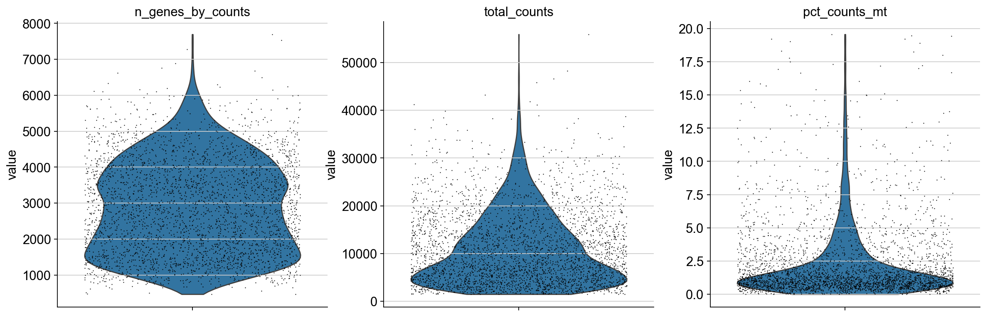

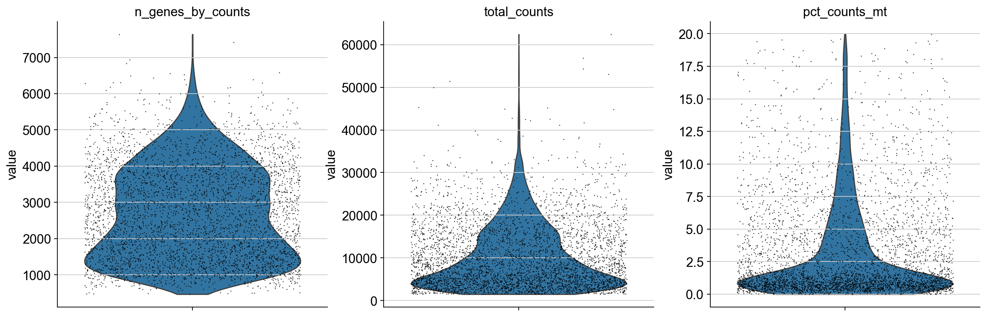

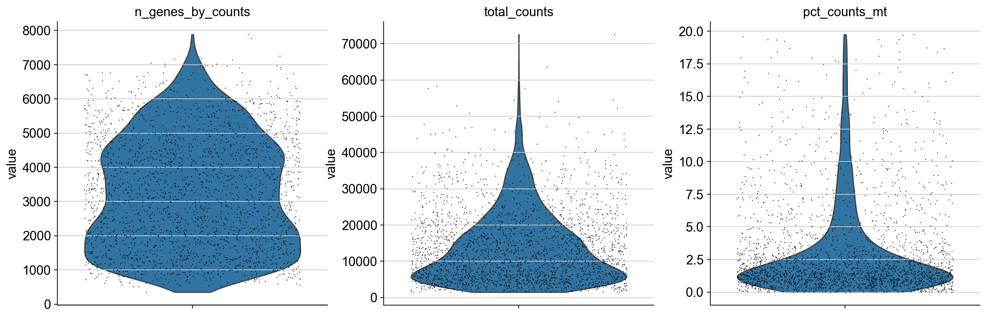

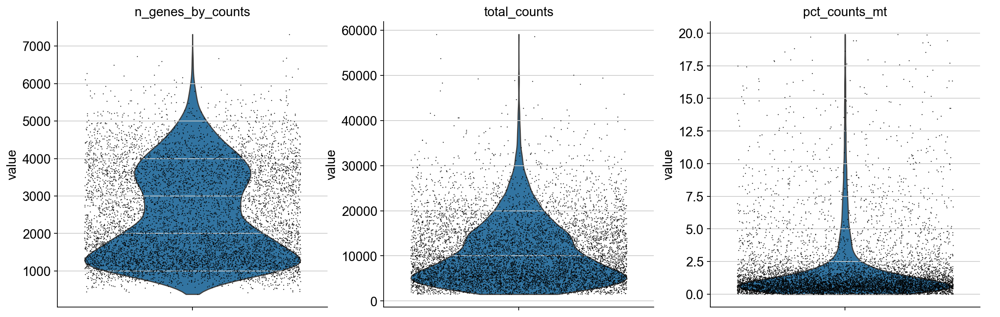

In [11]:
for x in range(0, len(adatas)):
    sc.pl.violin(adatas[x], ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
                 jitter=0.4, multi_panel=True, rotation=90) #groupby='Classification',

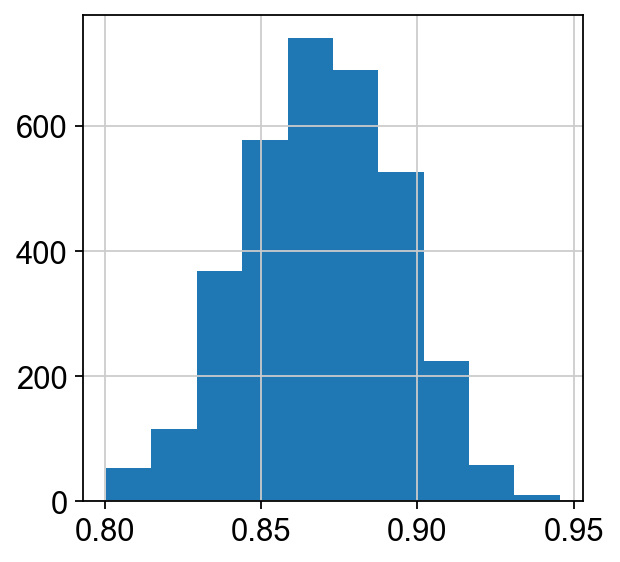

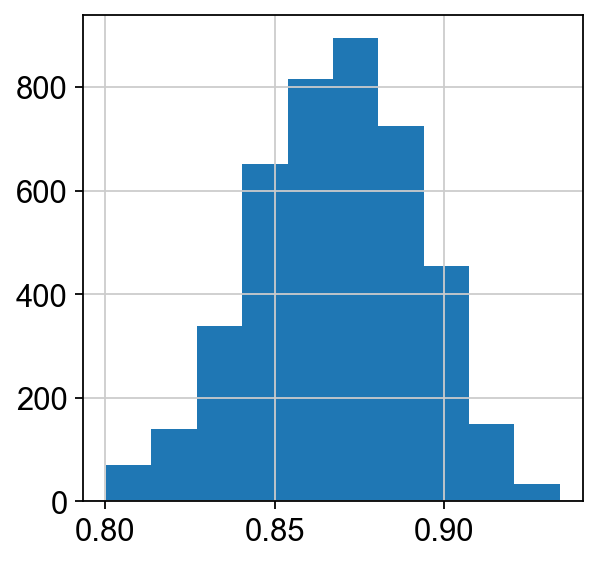

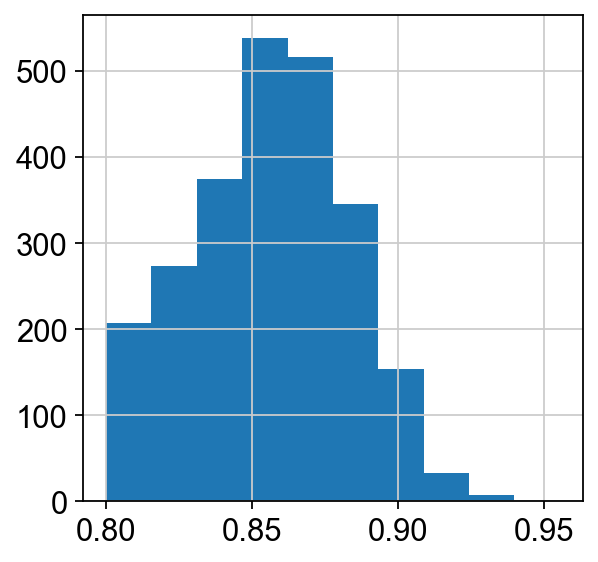

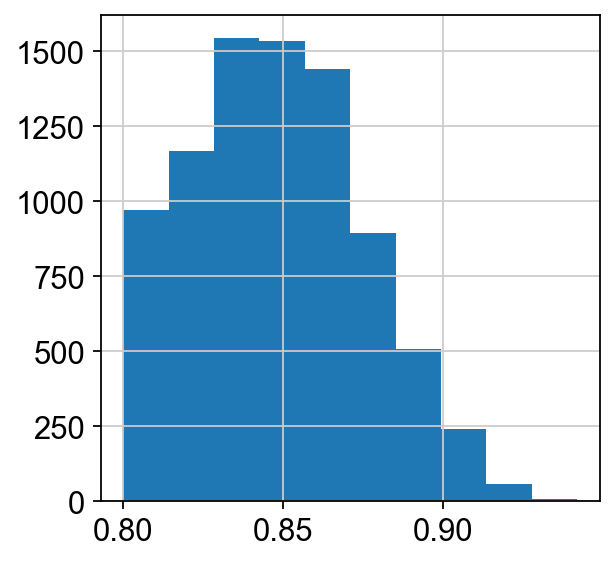

In [12]:
for x in range(0, len(adatas)):
    adatas[x].obs["log10GenesPerUMI"] = adatas[x].obs['n_genes_by_counts'].apply(math.log10) / adatas[x].obs['total_counts'].apply(math.log10)
    matplotlib.pyplot.hist(adatas[x].obs["log10GenesPerUMI"])
    matplotlib.pyplot.show()

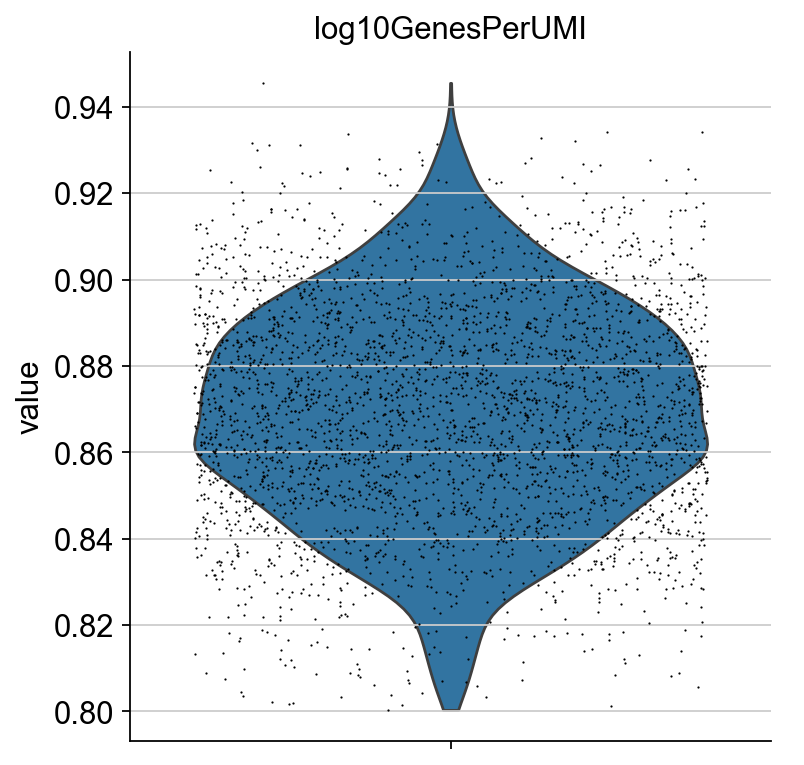

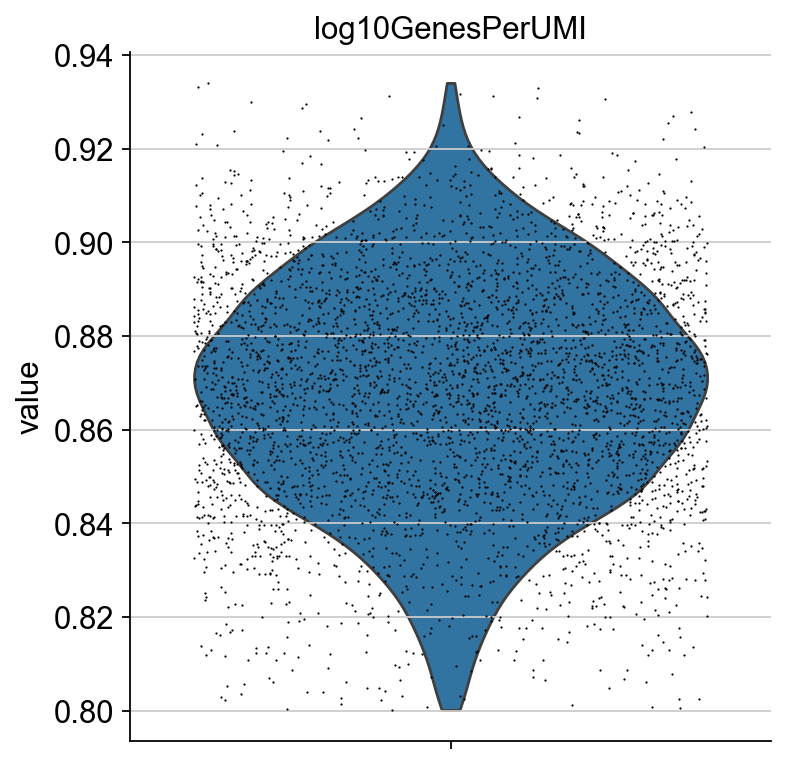

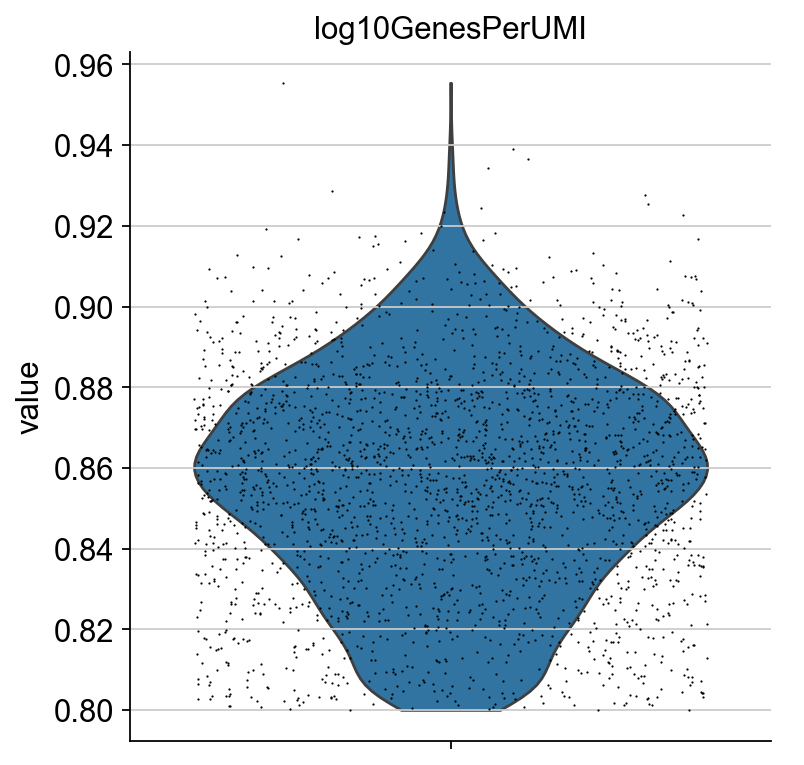

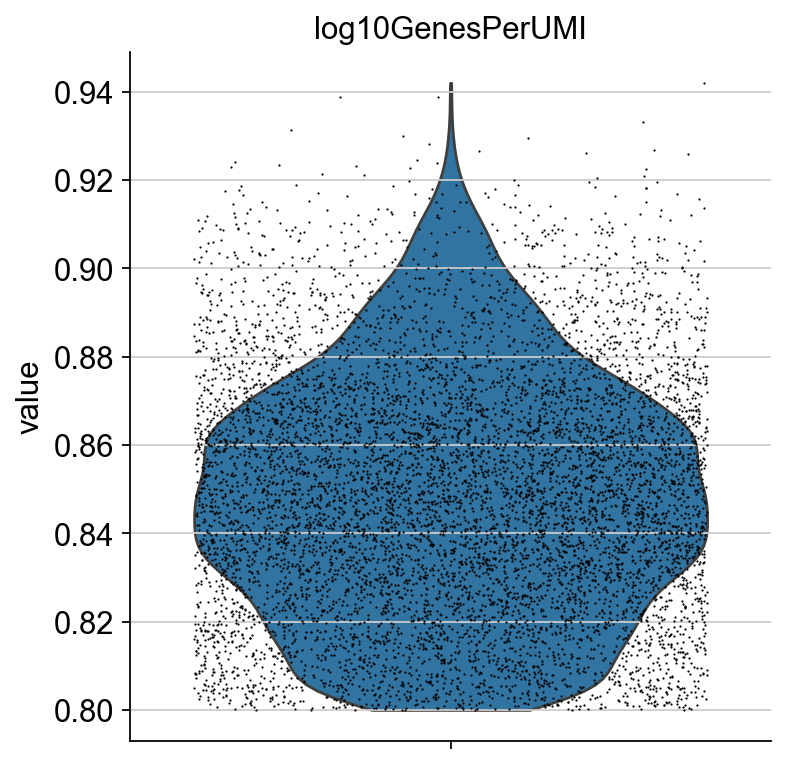

In [13]:
for x in range(0, len(adatas)):
    sc.pl.violin(adatas[x], ['log10GenesPerUMI'],
                 jitter=0.4, multi_panel=True, rotation=90)#groupby='Classification',


## Concatenate adatas or ingest or integrate

In [14]:
adata = adatas[0].concatenate(adatas[1:], join='outer', batch_categories=['shNfkb1_lane1', 'shNfkb1_lane2','shHairpins','IkbSR-Cre'])

/tmp/ipykernel_3277484/2408911170.py:1: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata = adatas[0].concatenate(adatas[1:], join='outer', batch_categories=['shNfkb1_lane1', 'shNfkb1_lane2','shHairpins','IkbSR-Cre'])


In [15]:
adata

AnnData object with n_obs × n_vars = 18456 × 30144
    obs: 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'shRen', '2118-Nfkb1', '2117-Nfkb1', 'GFP_count', 'Cre_count', 'shRNA', 'Group', 'shRela', 'shRel', 'batch'
    var: 'gene_ids-IkbSR-Cre', 'feature_types-IkbSR-Cre', 'genome-IkbSR-Cre', 'pattern-IkbSR-Cre', 'read-IkbSR-Cre', 'sequence-IkbSR-Cre', 'n_cells-IkbSR-Cre', 'mt-IkbSR-Cre', 'n_cells_by_counts-IkbSR-Cre', 'mean_counts-IkbSR-Cre', 'pct_dropout_by_counts-IkbSR-Cre', 'total_counts-IkbSR-Cre', 'highly_variable-IkbSR-Cre', 'means-IkbSR-Cre', 'dispersions-IkbSR-Cre', 'dispersions_norm-IkbSR-Cre', 'gene_ids-shHairpins', 'feature_types-shHairpins', 'genome-shHairpins', 'pattern-shHairpins', 'read-shHairpins', 'sequence-shHairpins', 'n_cells-shHairpins', 'mt-shHairpins', 'n_cells_by_counts-shHairpins', 'mean_counts-shHairpins', 'pct_dropout_by_counts-shHairpins', 'total_counts-shHairpins', 'highl

## Set highly variable genes based only on controls!

In [16]:
adata.obs[['batch','Group']].value_counts()

batch          Group       
IkbSR-Cre      Cre             5412
shNfkb1_lane2  shRenilla       3056
IkbSR-Cre      IkbSR-Cre       2955
shNfkb1_lane1  shRenilla       1839
               shNfkb1_2331    1478
shHairpins     shRela           923
shNfkb1_lane2  shNfkb1_2331     888
shHairpins     shRel            640
               shRenilla        489
               shNfkb1          398
shNfkb1_lane2  shNfkb1_3737     328
shNfkb1_lane1  shNfkb1_3737      50
Name: count, dtype: int64

In [17]:
adata_control = adata[adata.obs.Group.isin(['shRenilla']),:].copy()

In [18]:
sc.pp.normalize_total(adata_control, target_sum=1e4, layer="counts")
sc.pp.log1p(adata_control, layer="counts")

normalizing counts per cell
    finished (0:00:00)


In [19]:
sc.pp.highly_variable_genes(adata_control, batch_key='batch',layer='counts')

extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [20]:
adata

AnnData object with n_obs × n_vars = 18456 × 30144
    obs: 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'shRen', '2118-Nfkb1', '2117-Nfkb1', 'GFP_count', 'Cre_count', 'shRNA', 'Group', 'shRela', 'shRel', 'batch'
    var: 'gene_ids-IkbSR-Cre', 'feature_types-IkbSR-Cre', 'genome-IkbSR-Cre', 'pattern-IkbSR-Cre', 'read-IkbSR-Cre', 'sequence-IkbSR-Cre', 'n_cells-IkbSR-Cre', 'mt-IkbSR-Cre', 'n_cells_by_counts-IkbSR-Cre', 'mean_counts-IkbSR-Cre', 'pct_dropout_by_counts-IkbSR-Cre', 'total_counts-IkbSR-Cre', 'highly_variable-IkbSR-Cre', 'means-IkbSR-Cre', 'dispersions-IkbSR-Cre', 'dispersions_norm-IkbSR-Cre', 'gene_ids-shHairpins', 'feature_types-shHairpins', 'genome-shHairpins', 'pattern-shHairpins', 'read-shHairpins', 'sequence-shHairpins', 'n_cells-shHairpins', 'mt-shHairpins', 'n_cells_by_counts-shHairpins', 'mean_counts-shHairpins', 'pct_dropout_by_counts-shHairpins', 'total_counts-shHairpins', 'highl

In [21]:
# Now use highly variable of the control
adata.var.highly_variable = adata_control.var.highly_variable_intersection
adata.uns['hvg'] = adata_control.uns['hvg']

/tmp/ipykernel_3277484/4246112528.py:2: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  adata.var.highly_variable = adata_control.var.highly_variable_intersection


In [22]:
adata.var.highly_variable['mKate2'] = False
adata.var.highly_variable['GFP'] = False
adata.var.highly_variable['Cre'] = False
for x in library:
    adata.var.highly_variable[x] = False

/tmp/ipykernel_3277484/3376543771.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.var.highly_variable['mKate2'] = False
/tmp/ipykernel_3277484/3376543771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.var.highly_variable['GFP'] = False
/tmp/ipykernel_3277484/3376543771.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.var.highly_variable['Cre'] = False
/tmp/ipykernel_3277484/3376543771.py:5: SettingWithCopy

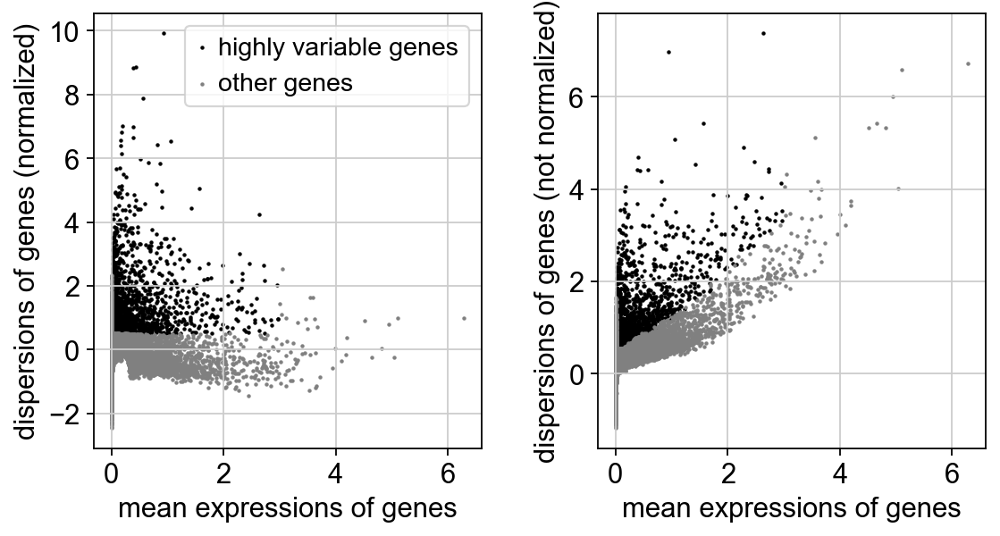

In [23]:
sc.pl.highly_variable_genes(adata_control) # on control genes

In [24]:
adata.X = adata.layers['counts'].copy()

In [25]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

normalizing counts per cell
    finished (0:00:00)


In [26]:
adata.raw = adata

In [27]:
# Convert all columns in adata.raw.var to string, to make this h5ad compatible
for col in adata.var.columns:
    series = adata.var[col]
    if pd.api.types.is_categorical_dtype(series) or pd.api.types.is_object_dtype(series):
        adata.var[col] = series.astype(str)

# Fix adata.raw.var
for col in adata.raw.var.columns:
    series = adata.raw.var[col]
    if pd.api.types.is_object_dtype(series):
        adata.raw.var[col] = series.astype(str)

adata.write('write/Nfkb_allmice.h5ad', compression='gzip')

/tmp/ipykernel_3277484/1962191680.py:4: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(series) or pd.api.types.is_object_dtype(series):
/tmp/ipykernel_3277484/1962191680.py:4: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(series) or pd.api.types.is_object_dtype(series):
/tmp/ipykernel_3277484/1962191680.py:4: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(series) or pd.api.types.is_object_dtype(series):
/tmp/ipykernel_3277484/1962191680.py:4: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDty

Actually do the filtering

In [26]:
GFPCells = adata[adata.obs['GFP_count'] >= 2,:].obs.index

In [27]:
CreCells = adata[adata.obs['Cre_count'] >= 2,:].obs.index

In [28]:
sc.pp.scale(adata, max_value=10, layer='counts')

/home/chanj2/part2a/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


## Calculate Barcode Stats

In [29]:
adata.obs[['Group','Classification']].value_counts(sort=False)

Group         Classification       
Cre           AY1264_B0301             1392
              AY1267_B0302              449
              AY1268_B0303              836
              AY1271_B0305             1483
              AY1422_B0304             1252
IkbSR-Cre     AY1262_B0306              121
              AY1263_B0307              349
              AY1425_B0308              628
              AY1483_B0309              890
              AY1484_B0310              967
shNfkb1       BD1939_B0303               75
              BE1137_B0304                5
              BE1155_(BD1672)_B0302     122
              BE1156_(BD1671)_B0301     196
shNfkb1_2331  AW1552_2117               888
              AX1508_2117               856
              AX1598_2117               622
shNfkb1_3737  AW1555_2118                50
              AX1123_2118               206
              AX1672_2118               122
shRel         BE1490_B0309              359
              BE1491-NT_B0310           

## Principal component analysis

In [30]:
sc.tl.pca(adata, svd_solver='arpack', n_comps=150,layer='counts')

computing PCA
    with n_comps=150
    finished (0:03:30)


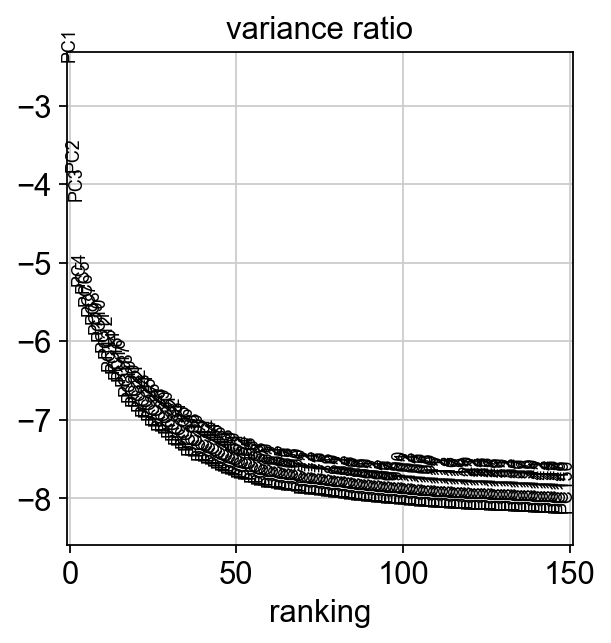

In [31]:
sc.pl.pca_variance_ratio(adata, log=True,n_pcs=150)

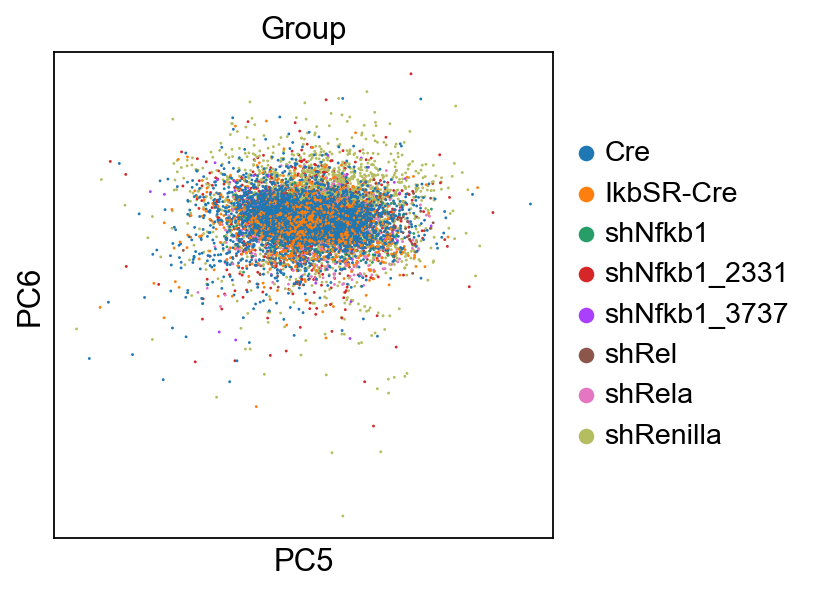

In [32]:
sc.pl.pca(
    adata,
    color="Group",   # or "sample_id"
    layer='counts',
    dimensions=(4,5)
)

In [33]:
adata.write(results_file, compression='gzip')

In [34]:
adata

AnnData object with n_obs × n_vars = 18456 × 30144
    obs: 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'shRen', '2118-Nfkb1', '2117-Nfkb1', 'GFP_count', 'Cre_count', 'shRNA', 'Group', 'shRela', 'shRel', 'batch'
    var: 'gene_ids-IkbSR-Cre', 'feature_types-IkbSR-Cre', 'genome-IkbSR-Cre', 'pattern-IkbSR-Cre', 'read-IkbSR-Cre', 'sequence-IkbSR-Cre', 'n_cells-IkbSR-Cre', 'mt-IkbSR-Cre', 'n_cells_by_counts-IkbSR-Cre', 'mean_counts-IkbSR-Cre', 'pct_dropout_by_counts-IkbSR-Cre', 'total_counts-IkbSR-Cre', 'highly_variable-IkbSR-Cre', 'means-IkbSR-Cre', 'dispersions-IkbSR-Cre', 'dispersions_norm-IkbSR-Cre', 'gene_ids-shHairpins', 'feature_types-shHairpins', 'genome-shHairpins', 'pattern-shHairpins', 'read-shHairpins', 'sequence-shHairpins', 'n_cells-shHairpins', 'mt-shHairpins', 'n_cells_by_counts-shHairpins', 'mean_counts-shHairpins', 'pct_dropout_by_counts-shHairpins', 'total_counts-shHairpins', 'highl

## Computing the neighborhood graph

In [42]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=50)

computing neighbors
    using 'X_pca' with n_pcs = 50


/home/chanj2/part2a/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:20)


## Embedding the neighborhood graph

In [43]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:34)


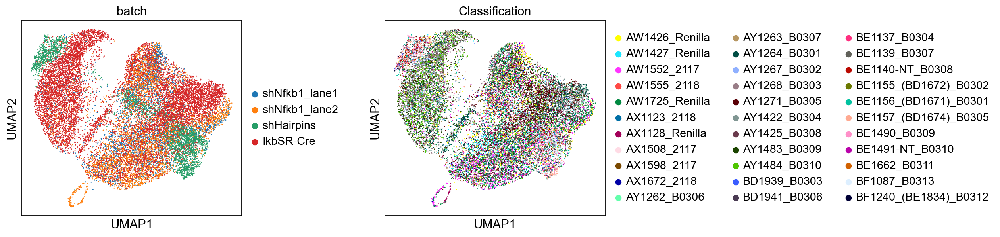

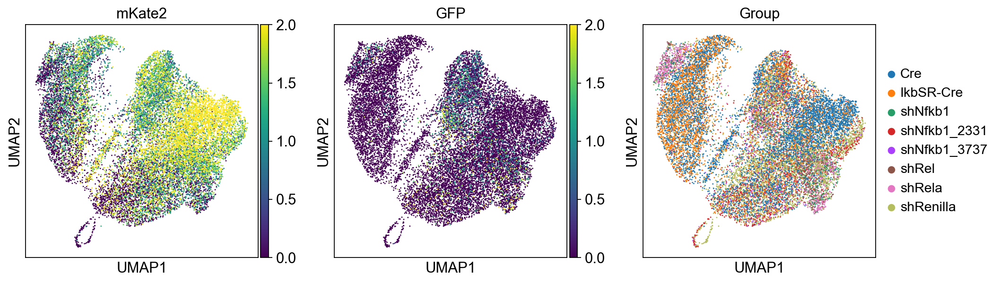

In [44]:
sc.pl.umap(adata, color=['batch', 'Classification'],wspace=0.5)
sc.pl.umap(adata, color=['mKate2', 'GFP','Group'],vmax=2)#'shRNA'
#sc.pl.umap(adata, color=['Porcn', 'Lgr5','Axin2']) #LGR6 not found
#sc.pl.umap(adata, color=['Vim', 'Cdh2','Cdh1','Epcam']) #CDH1,EPCAM not found
#sc.pl.umap(adata, color=['Slc4a11','Itga2', 'Cldn4'])
#sc.pl.umap(adata, color=['Hopx','Epcam','Sftpc','Pecam1'])
#sc.pl.umap(adata, color=['Cd109', 'Cd81'])
#sc.pl.umap(adata, color=['Trp53','Meg3','Ptprc', 'Kras'], vmax=3)


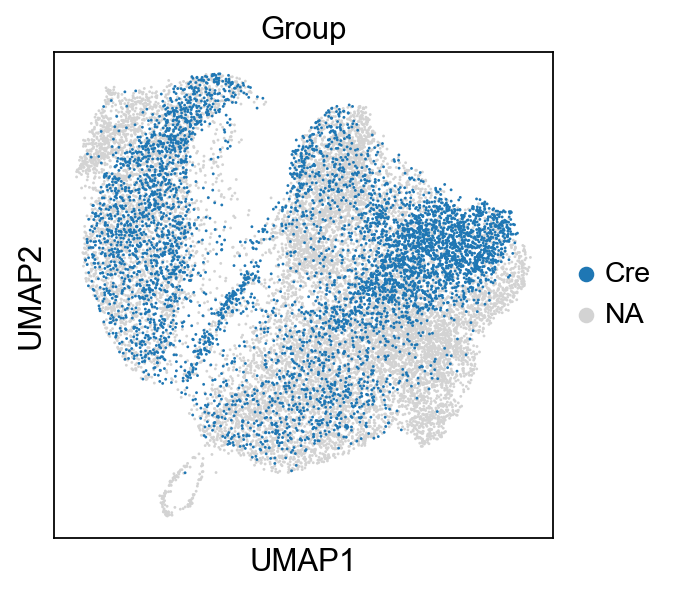

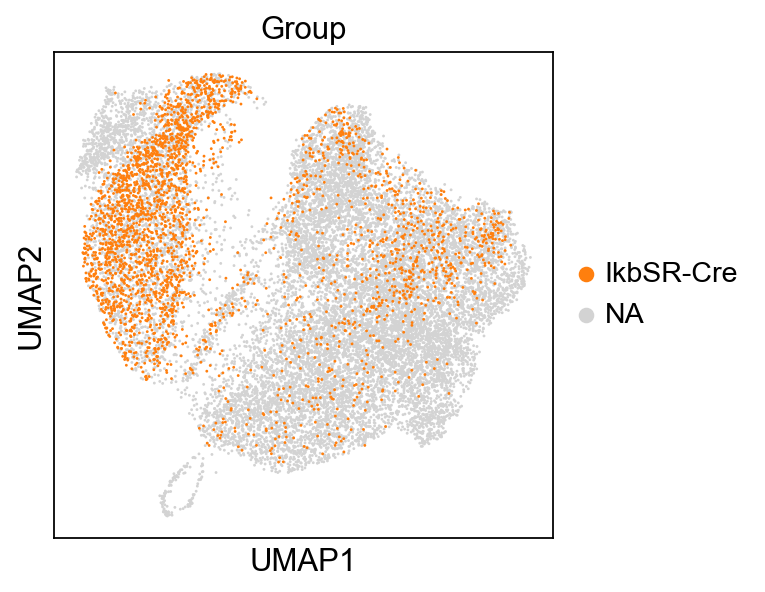

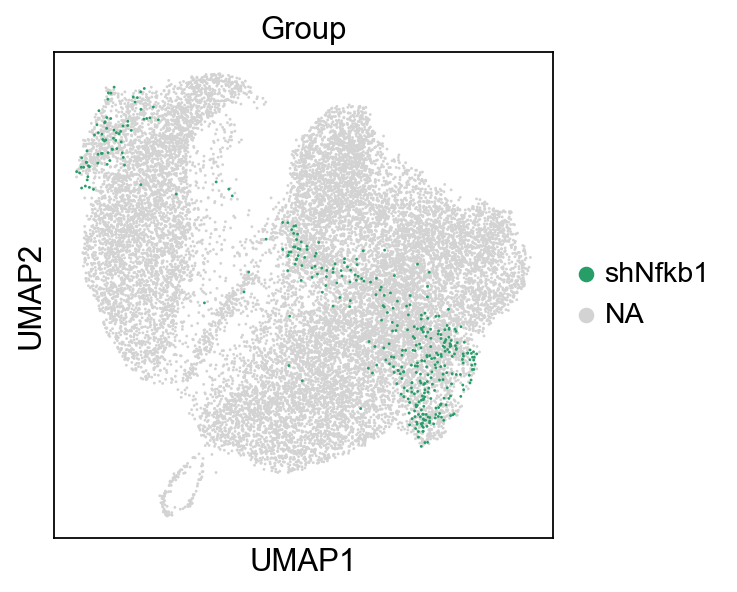

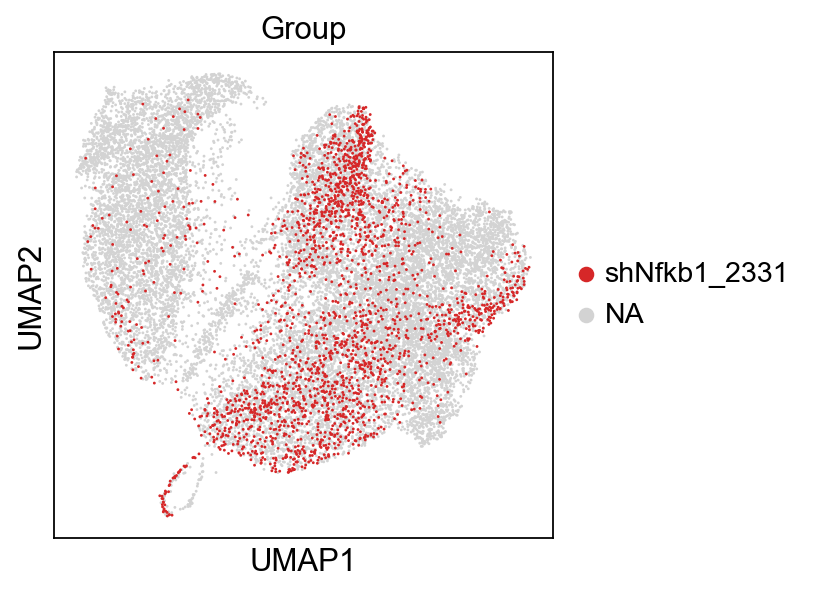

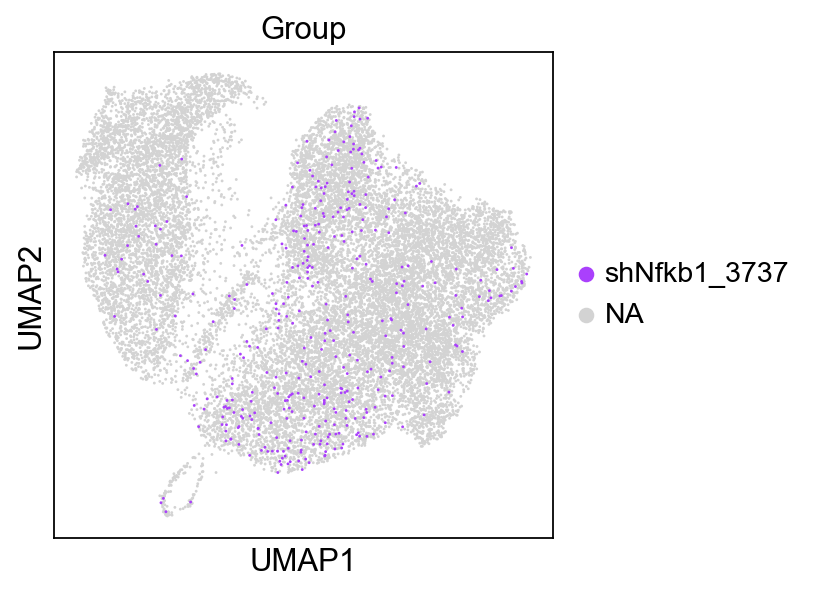

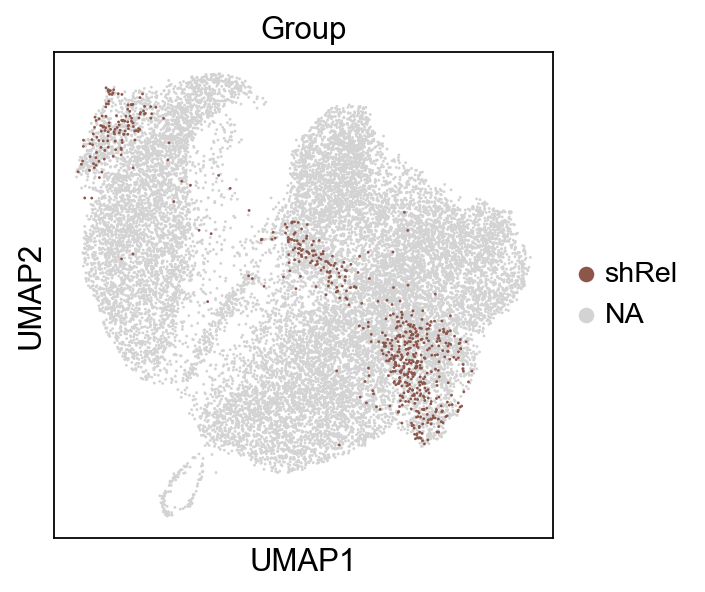

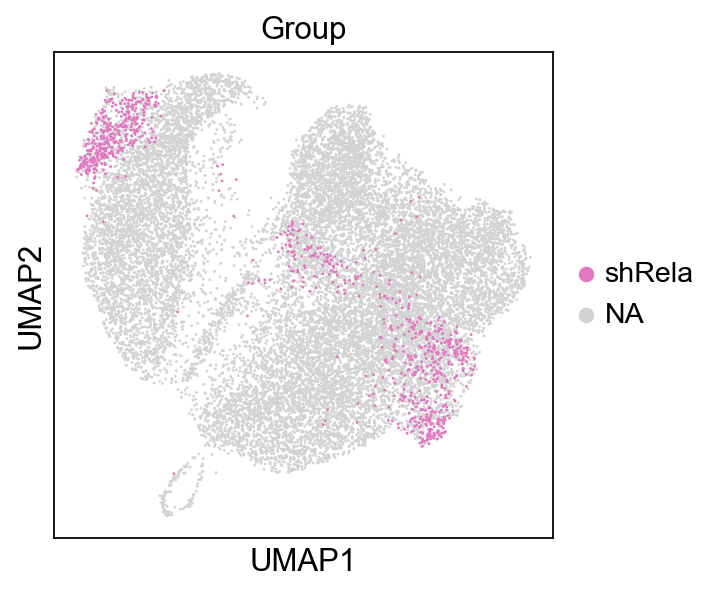

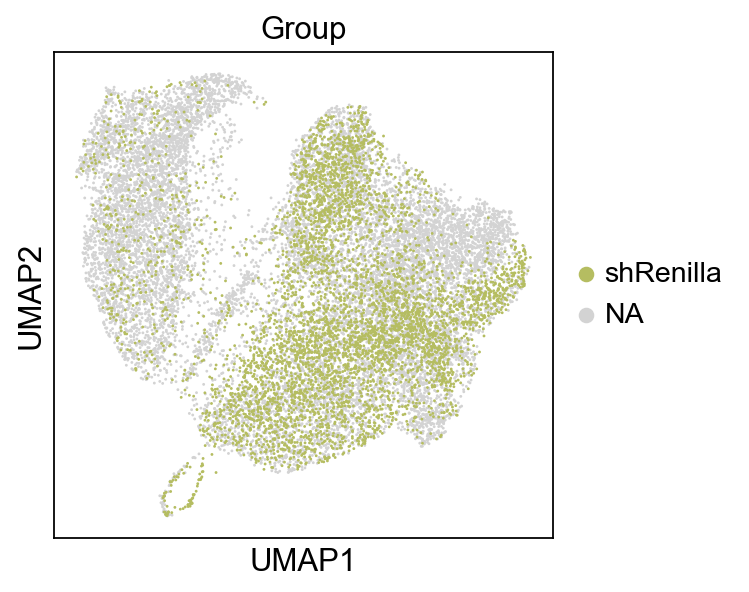

In [45]:
for x in adata.obs.Group.cat.categories:
    sc.pl.umap(adata, color='Group', groups=[x])

In [46]:
sc.tl.leiden(adata, resolution=0.4)

running Leiden clustering


/tmp/ipykernel_3157407/3931443330.py:1: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution=0.4)


    finished: found 7 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


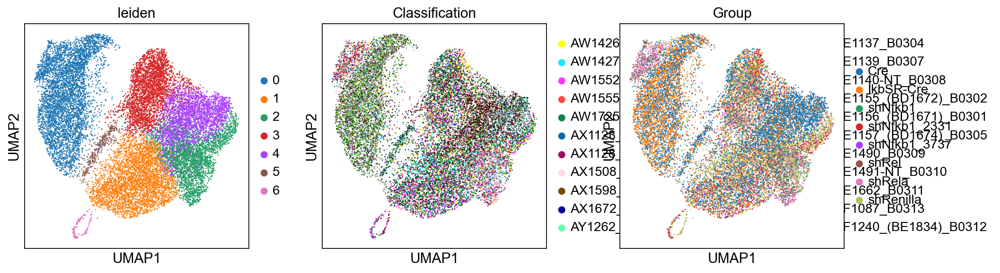

In [47]:
sc.pl.umap(adata, color = ['leiden', 'Classification', 'Group'])

## Check Nfkb1 expression

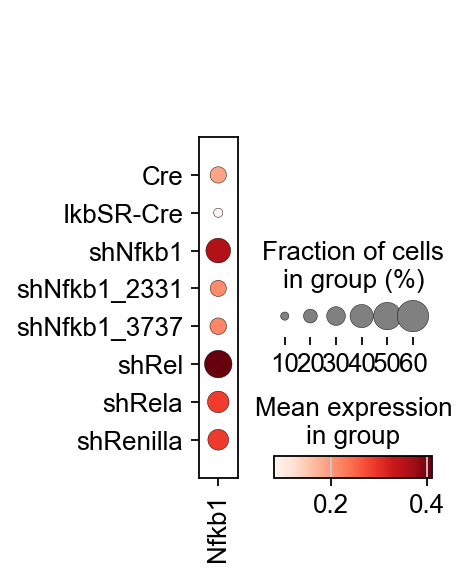

In [48]:
sc.pl.dotplot(adata, ['Nfkb1'], groupby='Group')

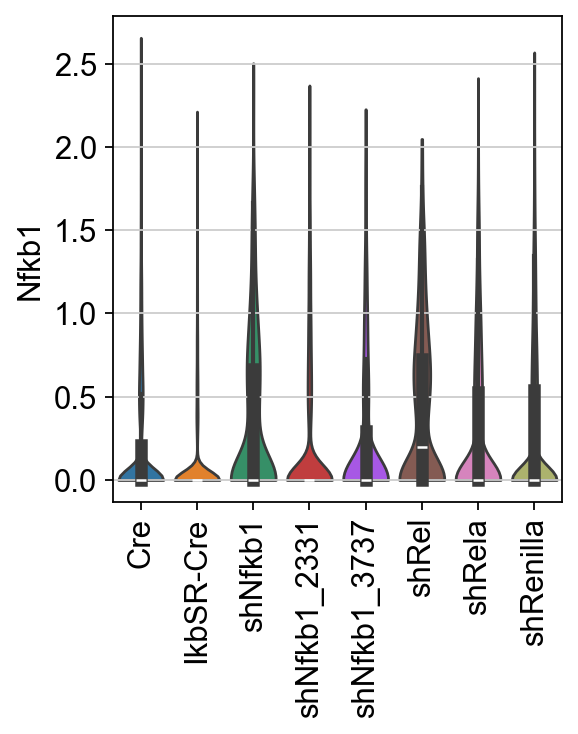

In [49]:
sc.pl.violin(adata,['Nfkb1'], groupby='Group',inner='box',stripplot=False, rotation=90)

## Investigate gene differences

## Plot marker genes

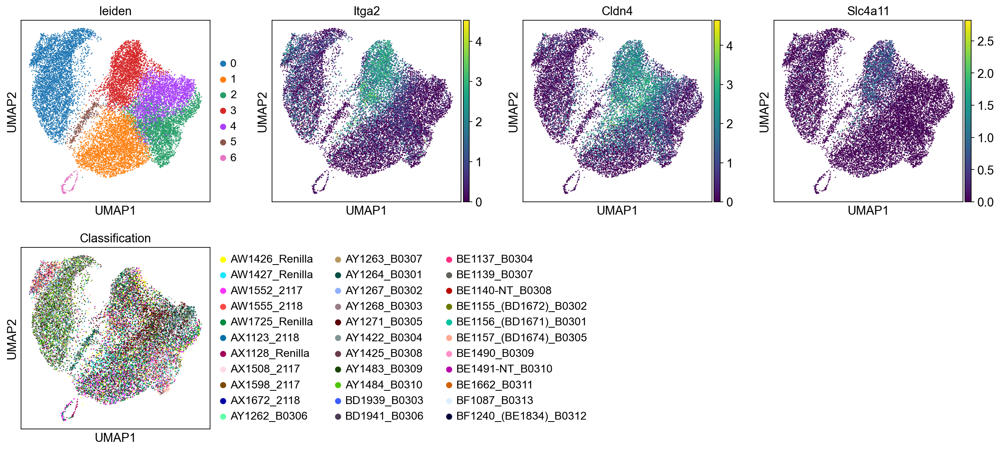

In [50]:
sc.pl.umap(adata, color=['leiden', 'Itga2', 'Cldn4', 'Slc4a11','Classification'])

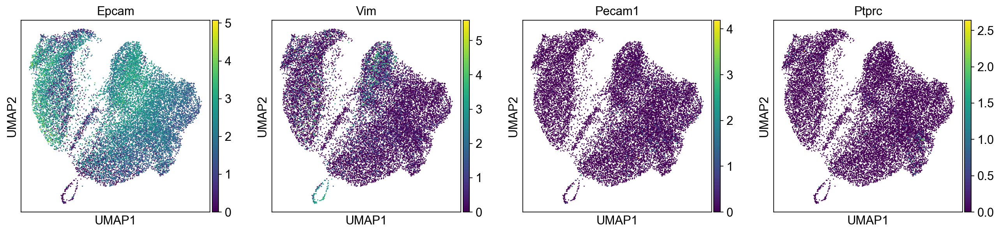

In [51]:
sc.pl.umap(adata, color=['Epcam', 'Vim', 'Pecam1','Ptprc'])

In [52]:
sc.tl.embedding_density(adata, basis='umap', groupby='Group')

computing density on 'umap'
--> added
    'umap_density_Group', densities (adata.obs)
    'umap_density_Group_params', parameter (adata.uns)


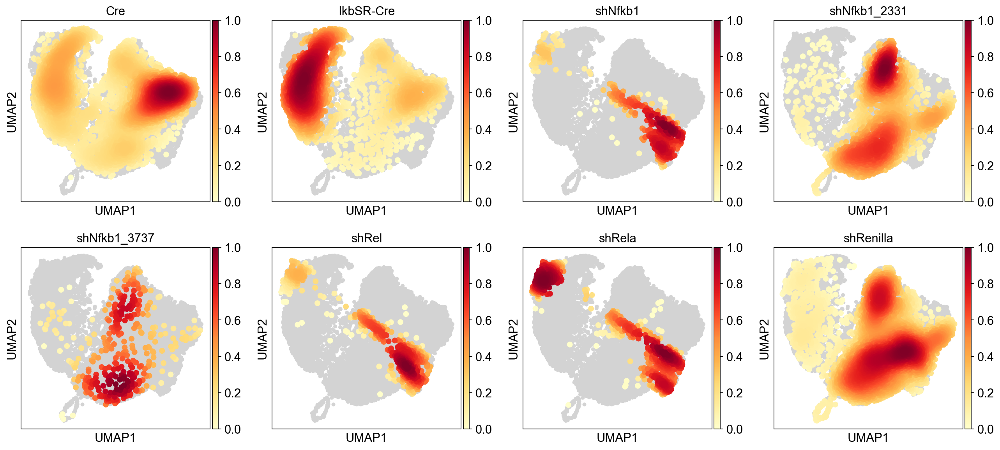

In [53]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_Group')

In [54]:
adata.obs.Group.value_counts()

Group
Cre             5412
shRenilla       5384
IkbSR-Cre       2955
shNfkb1_2331    2366
shRela           923
shRel            640
shNfkb1          398
shNfkb1_3737     378
Name: count, dtype: int64

In [55]:
sc.tl.embedding_density(adata, basis='umap', groupby='shRNA')

computing density on 'umap'
--> added
    'umap_density_shRNA', densities (adata.obs)
    'umap_density_shRNA_params', parameter (adata.uns)


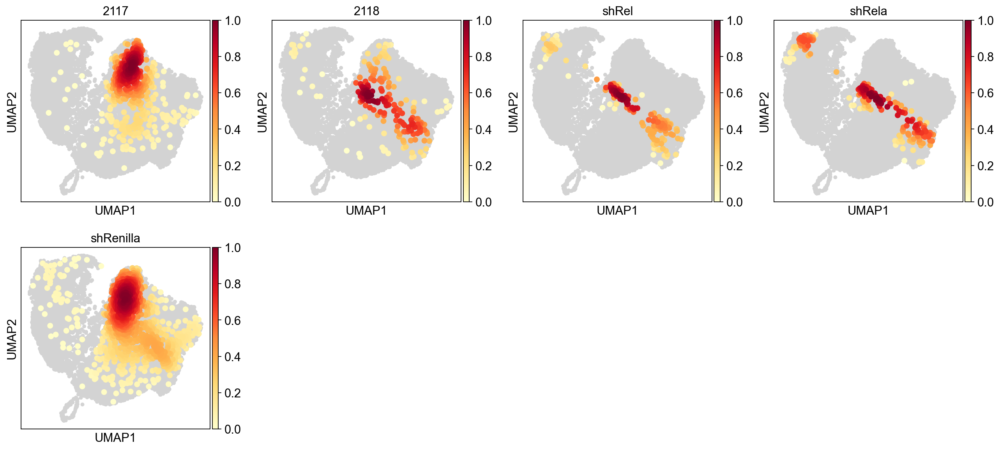

In [56]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_shRNA')

In [57]:
adata.obs.Group.value_counts()

Group
Cre             5412
shRenilla       5384
IkbSR-Cre       2955
shNfkb1_2331    2366
shRela           923
shRel            640
shNfkb1          398
shNfkb1_3737     378
Name: count, dtype: int64

## Define scoring functions

In [58]:
# Score Cluster 5 cells
import csv
clusters = {}
clusterkeys = []
HPCS = False

def resetClusters(hpcs = 'cell2020'):
    clusters = {}
    clusterkeys = []
    HPCS = False
    try:
        if hpcs == 'cell2020':         
            with open('../../common_files/clusters_cell2020.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = [x for x in row[1:] if x != '']
            for i in range(1,13):
                #if i == 9: continue
                clusterkeys.append('Cluster %i' % i)
            HPCS = 'Cluster 5'
        elif hpcs == 'cell2020_no_Slc4a11':         
            with open('../../common_files/clusters_cell2020.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = [x for x in row[1:] if x != '']   
                    if 'Slc4a11' in clusters[row[0]]:
                        clusters[row[0]].remove('Slc4a11')
                        print("Slc4a11 removed")
            for i in range(1,13):
                #if i == 9: continue
                clusterkeys.append('Cluster %i' % i)
            HPCS = 'Cluster 5'
        else:
            raise ValueError
    except ValueError:
        print("%s is an invalid choice" % hpcs)
        raise
    return (clusters, clusterkeys, HPCS)

(clusters, clusterkeys, HPCS) = resetClusters('cell2020')

In [59]:
def scoreAndPlot(ad, excludeList = None, groupby="Classification",rotation=90,numgenes=25,ctlgenes=25):
    #cmap = 'Reds' #colormap
    cmap = 'jet' #colormap
    if excludeList == None:
        for i in clusterkeys:
            if (numgenes > ctlgenes):
                ctlgenes = numgenes
            sc.tl.score_genes(ad, clusters[i][0:numgenes],score_name="%s" % i, ctrl_size=ctlgenes)  
        #sc.tl.score_genes(ad, clusters['Highly_mixed'],score_name="Highly_mixed")
  
        sc.pl.umap(ad, color=clusterkeys, color_map=cmap)
        sc.pl.dotplot(ad, clusterkeys, groupby=groupby, swap_axes=True)

In [60]:
from scipy.stats import ranksums

def HPCSViolinPlot(ad, cluster='0', groupby='leiden', score='Cluster5', save=None, singleGene=False):
    ad.obs['Cl5'] = 'not HPCS'
    ad.obs.loc[ad.obs[groupby].isin([cluster]), 'Cl5'] = 'HPCS'

    if singleGene:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray(),ad[~ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray())[1]
        #sc.pl.violin(ad, score, groupby='Cl5', xlabel = 'p = ' + str(pvalue), save=save)
    else:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])].obs[score],ad[ad.obs['Cl5'].isin(['not HPCS'])].obs[score])[1]
    sc.pl.violin(ad, score, groupby='Cl5', xlabel = 'p = ' + str(pvalue), save=save)

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    1394 total control genes are used. (0:00:00)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    1394 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    1293 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    1397 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    1394 total control genes are used. (0:00:00)
computing score 'Cluster 6'
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    1997 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: added
    'Cluster 7', score of gene set (adata.obs).
    1092 total control genes are u

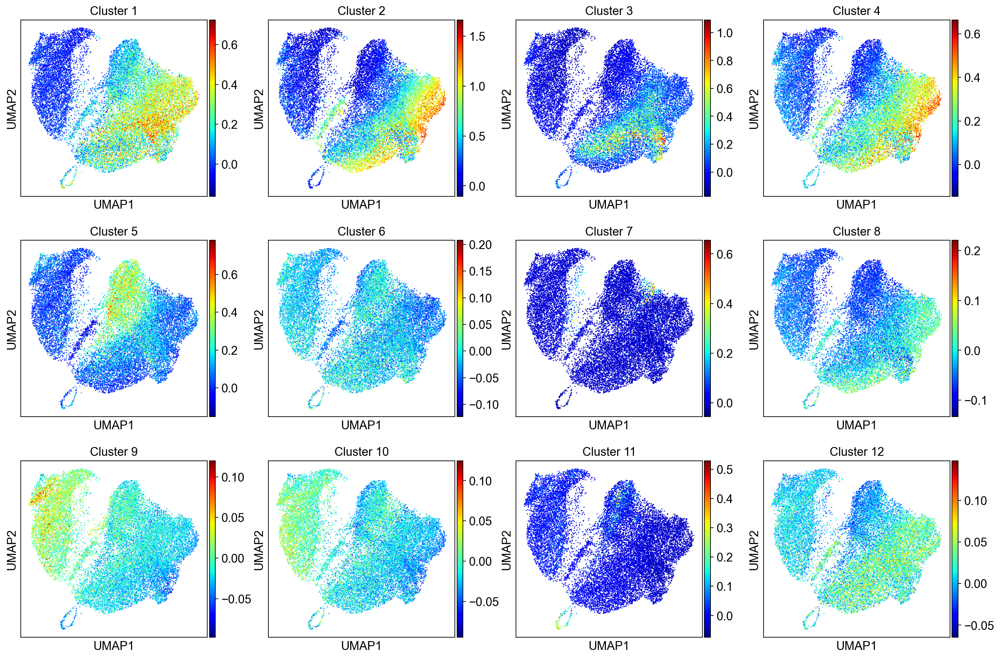

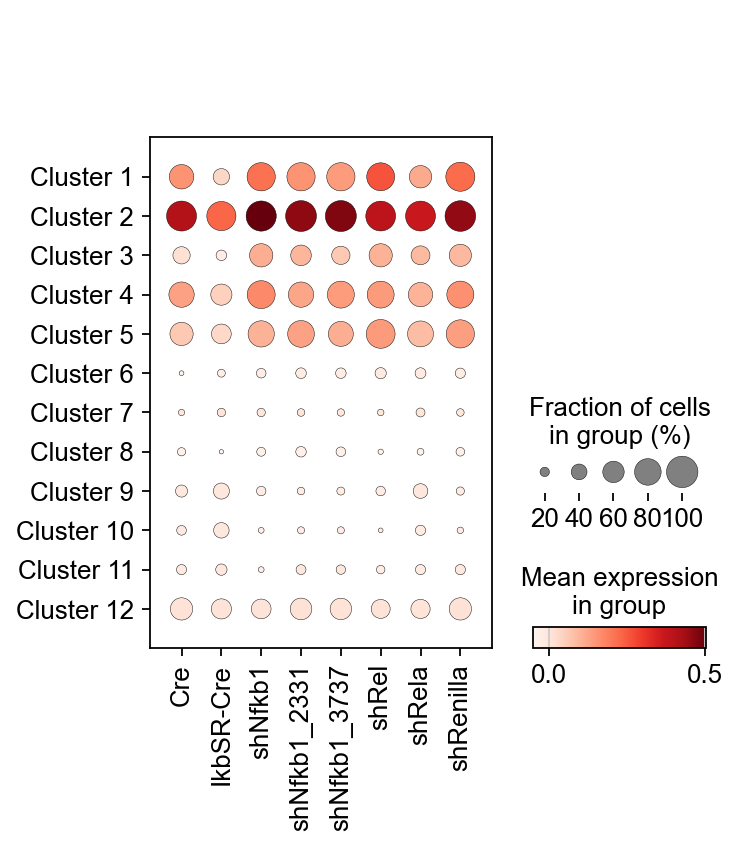

In [61]:
scoreAndPlot(adata, groupby='Group',numgenes=100)

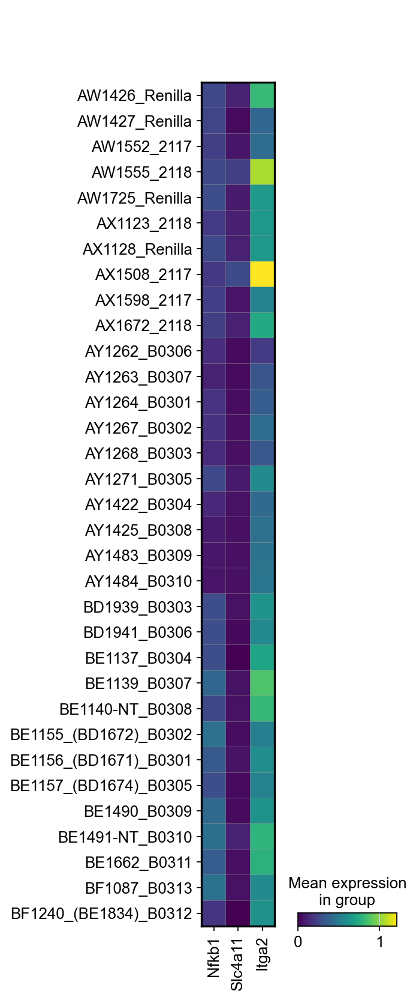

In [62]:
sc.pl.matrixplot(adata, ['Nfkb1','Slc4a11','Itga2',], groupby='Classification')

In [63]:
adata.obs[['Group','Classification']].value_counts(sort=False)

Group         Classification       
Cre           AY1264_B0301             1392
              AY1267_B0302              449
              AY1268_B0303              836
              AY1271_B0305             1483
              AY1422_B0304             1252
IkbSR-Cre     AY1262_B0306              121
              AY1263_B0307              349
              AY1425_B0308              628
              AY1483_B0309              890
              AY1484_B0310              967
shNfkb1       BD1939_B0303               75
              BE1137_B0304                5
              BE1155_(BD1672)_B0302     122
              BE1156_(BD1671)_B0301     196
shNfkb1_2331  AW1552_2117               888
              AX1508_2117               856
              AX1598_2117               622
shNfkb1_3737  AW1555_2118                50
              AX1123_2118               206
              AX1672_2118               122
shRel         BE1490_B0309              359
              BE1491-NT_B0310           

In [64]:
adata.obs[['Group','shRNA']].value_counts()

Group         shRNA    
shRenilla     shRenilla    1020
shNfkb1_2331  2117          517
shRela        shRela        191
shRel         shRel         169
shNfkb1       2118          107
shNfkb1_3737  2118           94
shNfkb1_2331  shRenilla       2
shNfkb1_3737  2117            1
Name: count, dtype: int64

## Logistic Regression

In [65]:
from sklearn.linear_model import LogisticRegression
from joblib import dump, load
names = load('../../common_files/genes.joblib')

In [66]:
adata_log = adata[:,adata.var.index.isin(names)]

In [67]:
adata_names = [x for x in adata_log.var.index]

In [68]:
goi = [x for x in adata_log.var.index]

## Load SmartSeq h5ad file

In [69]:
smartseq = anndata.read_h5ad('../../Marjanovic_et_al_2020/write/Marjanovic_et_al_LUAD_data.h5ad')

## Logistic Regression against Cancer Cell 2020 Clusters intersected with 10x data

In [70]:
from sklearn.model_selection import train_test_split

names_adata = smartseq[:,smartseq.var.index.isin(goi)]

X_train, X_test, y_train, y_test = train_test_split(names_adata.X, smartseq.obs['clusterK12'], test_size=0.25, random_state=250)

In [71]:
names = [x for x in names_adata.var.index]

In [72]:
# import the class
from sklearn.linear_model import LogisticRegression

# instantiate the model (using the default parameters)
#logreg = LogisticRegression(random_state=250,multi_class='multinomial', solver='lbfgs')
logreg = LogisticRegression(random_state=250, solver='lbfgs')

# fit the model with data
logreg.fit(X_train, y_train)

y_pred = logreg.predict(X_test)
y_score = logreg.predict_proba(X_test)


In [73]:
# import the metrics class
from sklearn import metrics

cnf_matrix = metrics.confusion_matrix(y_test, y_pred)
cnf_matrix

array([[142,   5,   2,   0,   1,   1,   1,   0,   0,   0,   0,   0],
       [  8,  69,   0,   3,   0,   0,   0,   0,   0,   0,   0,   0],
       [  0,   0,  41,   0,   3,   0,   0,   2,   0,   1,   0,   0],
       [  1,   1,   0,  67,   0,   0,   0,   7,   1,   0,   0,   0],
       [  1,   0,   3,   0, 179,   1,   0,   4,   0,   0,   0,   1],
       [  0,   0,   0,   1,   0,  33,   0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,  14,   1,   0,   0,   0,   0],
       [  0,   0,   1,   1,   1,   0,   0, 139,   1,   0,   0,   1],
       [  0,   0,   0,   1,   1,   0,   0,   1,  38,   1,   0,   0],
       [  0,   0,   1,   1,   2,   0,   0,   3,   0,  55,   0,   1],
       [  0,   0,   0,   0,   0,   0,   0,   0,   1,   0,  13,   0],
       [  0,   0,   0,   0,   1,   0,   0,   0,   1,   0,   0,  41]])

Text(0.5, 295.64444444444445, 'Predicted label')

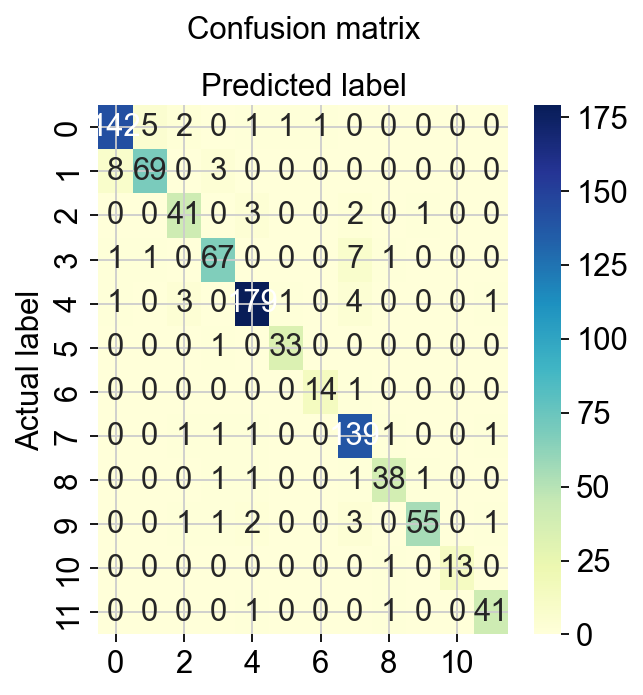

In [74]:
# import required modules
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

class_names=[0,1] # name  of classes
fig, ax = plt.subplots()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks, class_names)
# create heatmap
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, cmap="YlGnBu" ,fmt='g')
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix', y=1.1)
plt.ylabel('Actual label')
plt.xlabel('Predicted label')

#Text(0.5,257.44,'Predicted label');

In [75]:
from sklearn.metrics import classification_report
target_names = ['1', '2', '3','4','5','6','7','8','9','10','11','12']
print(classification_report(y_test, y_pred, target_names=target_names))

              precision    recall  f1-score   support

           1       0.93      0.93      0.93       152
           2       0.92      0.86      0.89        80
           3       0.85      0.87      0.86        47
           4       0.91      0.87      0.89        77
           5       0.95      0.95      0.95       189
           6       0.94      0.97      0.96        34
           7       0.93      0.93      0.93        15
           8       0.89      0.97      0.92       144
           9       0.90      0.90      0.90        42
          10       0.96      0.87      0.92        63
          11       1.00      0.93      0.96        14
          12       0.93      0.95      0.94        43

    accuracy                           0.92       900
   macro avg       0.93      0.92      0.92       900
weighted avg       0.92      0.92      0.92       900



In [76]:
from sklearn.preprocessing import LabelBinarizer

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)
y_onehot_test.shape  # (n_samples, n_classes)

(900, 12)

In [77]:
class_of_interest = '09'
class_id = np.flatnonzero(label_binarizer.classes_ == class_of_interest)[0]
class_id

np.int64(8)

/home/chanj2/part2a/lib/python3.11/site-packages/sklearn/utils/_plotting.py:176: FutureWarning: `**kwargs` is deprecated and will be removed in 1.9. Pass all matplotlib arguments to `curve_kwargs` as a dictionary instead.
  warnings.warn(


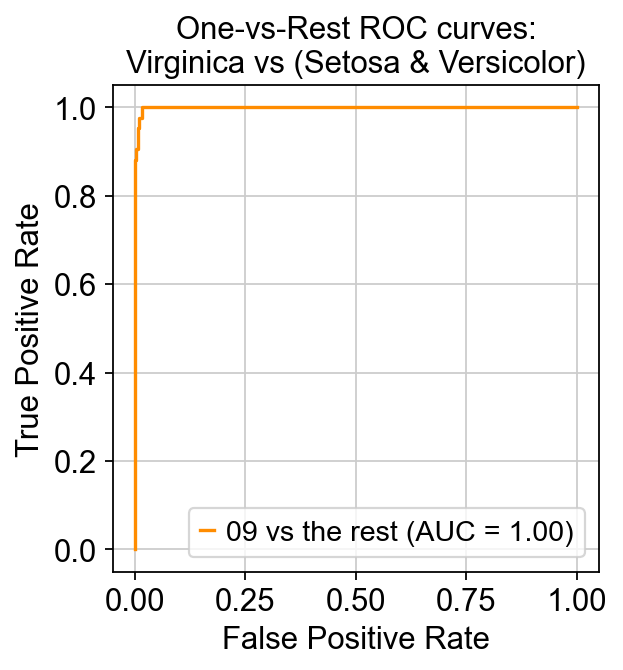

In [78]:
import matplotlib.pyplot as plt

from sklearn.metrics import RocCurveDisplay

RocCurveDisplay.from_predictions(
    y_onehot_test[:, class_id],
    y_score[:, class_id],
    name=f"{class_of_interest} vs the rest",
    color="darkorange",
    #plot_chance_level=True,
)
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("One-vs-Rest ROC curves:\nVirginica vs (Setosa & Versicolor)")
plt.legend()
plt.show()

In [79]:
y_pred = logreg.predict(smartseq[:,names].X)
y_proba = logreg.predict_proba(smartseq[:,names].X)

In [80]:
smartseq.obs['clusterK12_intersecting'] = [x for x in y_pred]
smartseq.obs['clusterK12_intersecting'] = smartseq.obs['clusterK12_intersecting'].astype('category')

In [81]:
#results_binary = y_pred
#probs_binary = y_proba

results_binary = logreg.predict(X_test)
probs_binary = logreg.predict_proba(X_test)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
results_df_binary['actual'] = list(y_test)
for x in range(0,12):
    results_df_binary["probability_%d" % (x+1)] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[["probability_%d" % (x+1) for x in range(0,12)]].max(axis=1)
results_df_binary['correct'] = (results_df_binary['predicted'] == results_df_binary['actual']).astype(int)
results_df_binary

,predicted,actual,probability_1,probability_2,probability_3,probability_4,probability_5,probability_6,probability_7,probability_8,probability_9,probability_10,probability_11,probability_12,highest_prob,correct
0,08,03,1.896677e-08,1.104040e-04,1.265017e-01,2.269290e-02,1.578338e-06,4.607005e-05,4.212746e-04,8.495628e-01,2.662443e-06,2.749004e-05,2.328337e-05,6.097930e-04,0.849563,0
1,01,01,9.999906e-01,2.414534e-07,1.288193e-08,8.016583e-08,1.062604e-07,1.109495e-06,7.674120e-06,2.856859e-10,2.471905e-09,7.131279e-09,1.139959e-07,8.319171e-09,0.999991,1
2,08,08,4.444059e-09,2.833286e-07,3.637319e-07,2.028521e-06,7.083355e-06,8.555677e-07,3.586807e-05,9.998774e-01,9.576199e-06,6.014343e-05,5.910254e-06,5.079893e-07,0.999877,1
3,10,10,4.274949e-08,6.564516e-06,2.804407e-05,3.117924e-07,4.965112e-01,5.979619e-04,6.576408e-05,3.740423e-05,3.246129e-04,5.014099e-01,7.808219e-05,9.401729e-04,0.501410,1
4,08,08,7.866698e-08,5.596315e-07,7.523457e-08,5.238834e-06,1.319768e-05,1.537257e-06,1.310276e-04,9.995450e-01,2.672763e-04,2.164140e-05,7.425562e-06,6.907890e-06,0.999545,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
895,05,05,2.685178e-04,1.686004e-07,3.300501e-06,4.139595e-05,9.898892e-01,4.777508e-03,3.475194e-04,2.302037e-03,7.301357e-04,1.456093e-03,1.721962e-04,1.197040e-05,0.989889,1
896,05,05,3.039001e-10,3.641265e-07,2.482612e-07,1.765374e-07,9.999855e-01,6.906104e-06,3.678000e-07,5.996847e-10,1.205435e-07,2.424209e-07,5.139545e-06,9.295733e-07,0.999986,1
897,08,08,2.576195e-06,5.876317e-05,8.482819e-06,1.331142e-02,5.480101e-08,4.506676e-06,9.490401e-05,9.852411e-01,1.066680e-03,1.632557e-04,2.110188e-05,2.713873e-05,0.985241,1
898,05,05,6.414003e-11,2.097115e-07,4.212077e-06,8.106254e-12,9.999942e-01,6.490402e-08,2.940330e-07,4.398264e-07,6.590618e-08,7.508539e-08,3.450006e-07,1.232752e-07,0.999994,1


In [82]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','correct','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high,correct
0,0.35-0.88,0.352772,0.879959,0.635659
1,0.88-0.98,0.879959,0.980087,0.890625
2,0.98-1.0,0.980087,0.996538,0.953488
3,1.0-1.0,0.999017,0.999880,0.996109


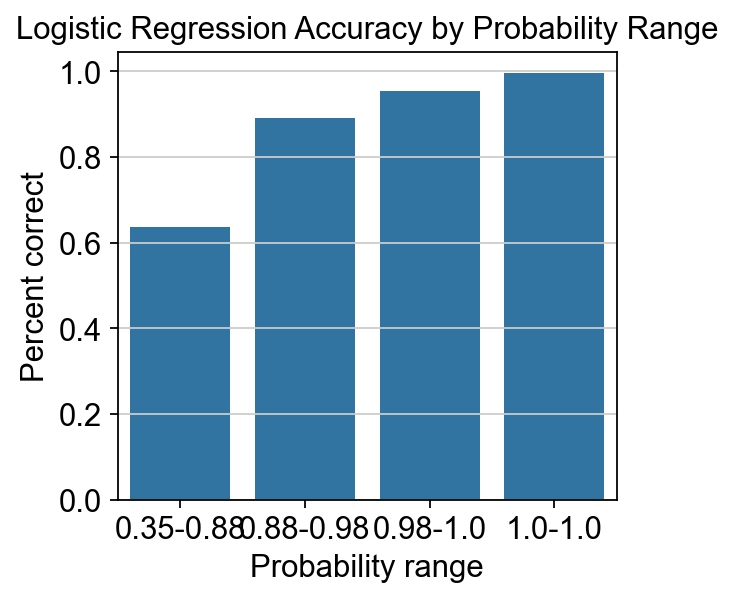

In [83]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(4,4))
plt.subplots_adjust(top=0.85)
#plt.figure(figsize=(11,9))
#plt.subplots_adjust(top=0.85)

ax = sns.barplot(x='prob range', y='correct', data=df_bins_grouped)
plt.title("Logistic Regression Accuracy by Probability Range")
plt.ylabel('Percent correct')
plt.xlabel('Probability range')
plt.show()

In [84]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

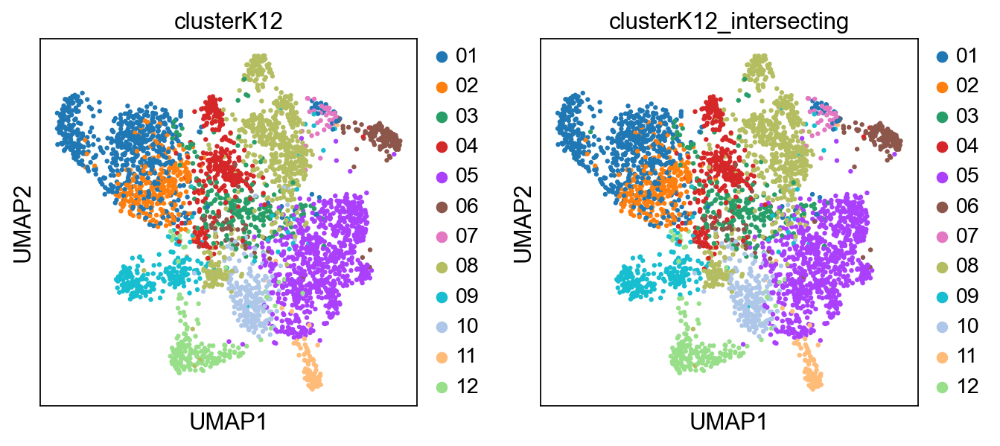

In [85]:
sc.pl.umap(smartseq, color=['clusterK12','clusterK12_intersecting'])

In [86]:
dict = {1: "01", 2: "02", 3: "03", 4: "04", 5: "05", 6: "06", 7: "07", 8: "08", 9: "09", 10: "10", 11: "11", 12: "12"}

In [87]:
from sklearn.metrics import accuracy_score
accuracy_score(smartseq.obs.replace({"clusterK12": dict})['clusterK12'], smartseq.obs['clusterK12_intersecting'])

0.9808333333333333

In [88]:
results_binary = logreg.predict(smartseq[:,names].X)
probs_binary = logreg.predict_proba(smartseq[:,names].X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,11,1.156910e-12,1.602262e-10,1.005394e-10,3.510507e-13,1.695650e-08,2.950238e-11,4.551025e-09,9.459545e-12,1.918250e-10,8.298439e-11,1.000000e+00,1.378005e-09,1.000000
1,12,2.333329e-10,2.758612e-11,1.056866e-10,2.766396e-09,3.068768e-09,9.850747e-07,1.837634e-08,4.797098e-08,1.080586e-07,4.240272e-07,1.039453e-08,9.999984e-01,0.999998
2,05,8.490103e-04,2.525827e-07,3.464038e-04,1.543503e-07,9.987798e-01,1.859120e-05,6.919855e-07,1.004194e-10,2.852844e-07,1.049908e-06,9.233958e-07,2.795467e-06,0.998780
3,10,5.450218e-07,3.939042e-07,5.355890e-07,1.716176e-03,7.040534e-07,9.757251e-06,7.501653e-06,2.573816e-03,7.974590e-06,9.956607e-01,4.559533e-06,1.729422e-05,0.995661
4,01,9.999964e-01,5.851251e-09,1.448734e-06,1.566538e-06,1.035455e-08,1.031367e-07,7.313704e-08,2.078269e-10,1.778952e-10,8.031021e-09,3.182625e-07,1.784851e-08,0.999996
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3595,08,2.998315e-10,8.883764e-08,6.717025e-09,1.321921e-07,1.229133e-08,7.057053e-09,5.552656e-07,9.999959e-01,3.048620e-06,1.363772e-07,5.610902e-08,8.832881e-09,0.999996
3596,09,7.860907e-08,2.461864e-07,1.173520e-07,7.523970e-08,1.149166e-06,5.542862e-08,1.266643e-06,3.602564e-04,9.996332e-01,2.341331e-07,3.164424e-06,1.085171e-07,0.999633
3597,08,3.549484e-08,4.060134e-06,8.187460e-08,4.270712e-05,2.408941e-08,5.407811e-08,7.074861e-06,9.998488e-01,9.156618e-05,2.647809e-06,2.121273e-06,8.560676e-07,0.999849
3598,08,7.846471e-09,2.042747e-06,2.724820e-06,2.209631e-06,3.791102e-04,2.194358e-07,1.041683e-05,9.995734e-01,9.325386e-06,1.467296e-05,4.116882e-06,1.710724e-06,0.999573


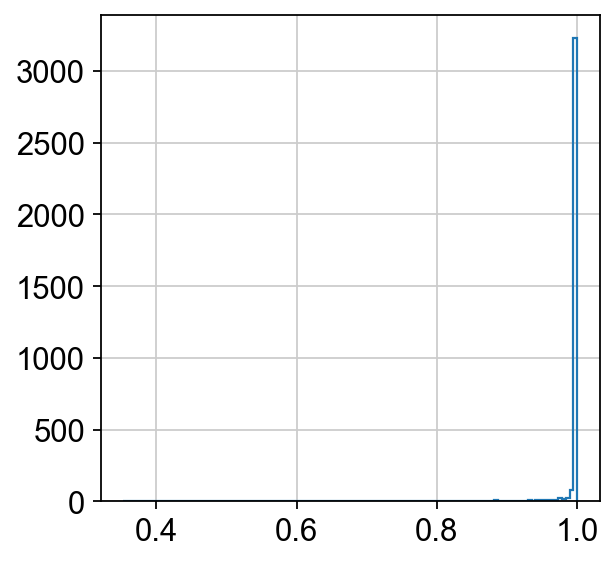

In [89]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto', histtype='step')

## Evaluate LogisticRegression

In [90]:
adata_ordered_genes = [adata_names.index(x) for x in names]

In [91]:
adata_log_ordered = adata_log[:,adata_ordered_genes]

In [92]:
y_pred = logreg.predict(adata_log_ordered.X)

In [93]:
adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]
adata_log_ordered.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')

/tmp/ipykernel_3157407/3908199522.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]


In [94]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

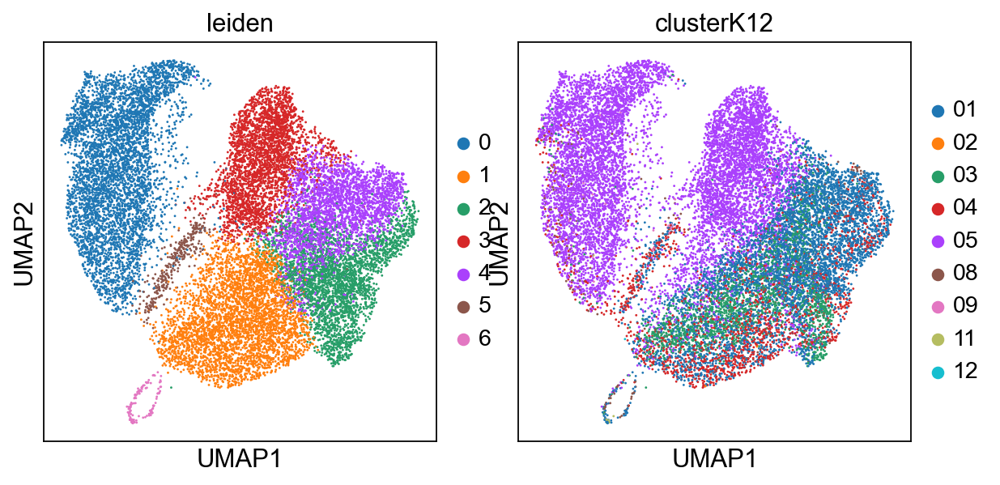

In [95]:
sc.pl.umap(adata_log_ordered,color=['leiden','clusterK12'], wspace=0.1)

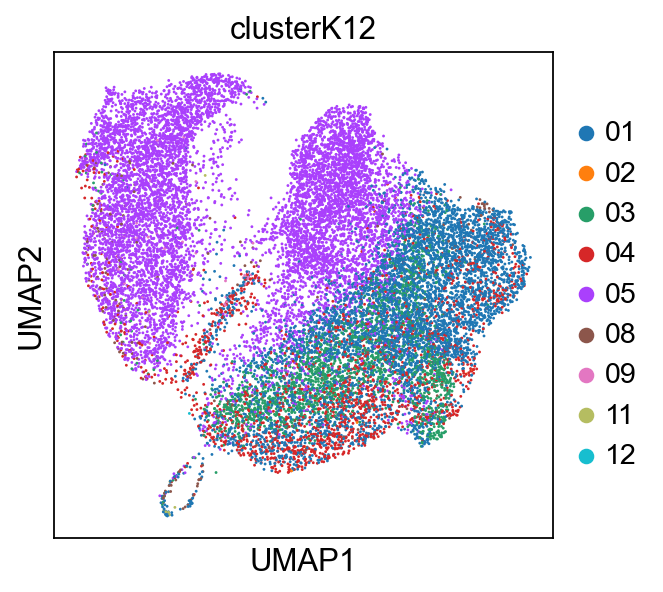

In [96]:
sc.pl.umap(adata_log_ordered,color=['clusterK12'])

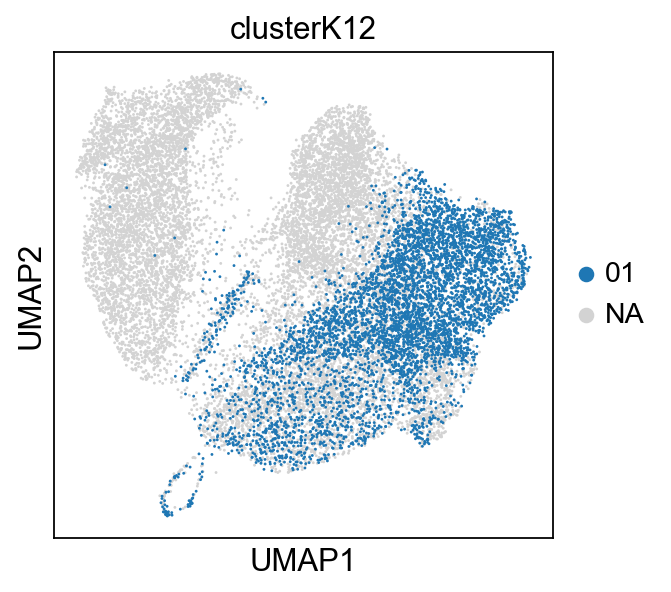

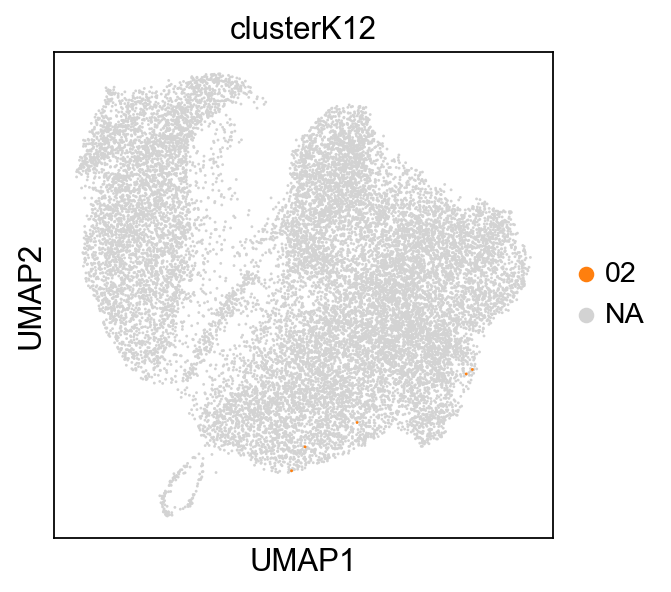

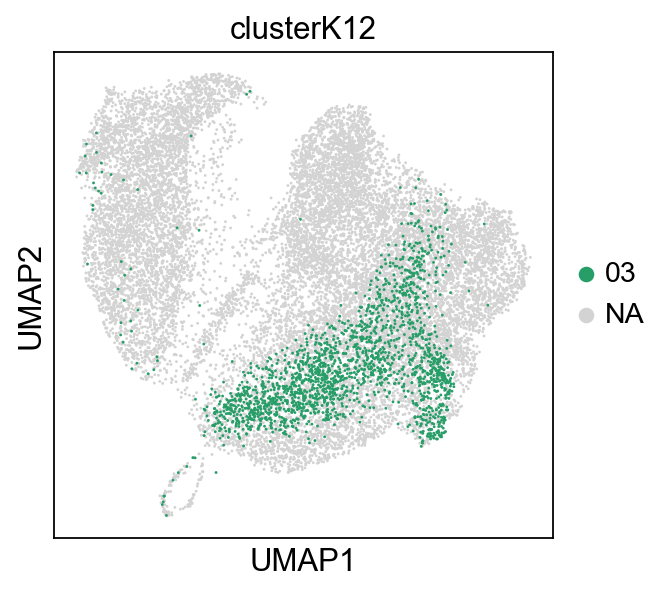

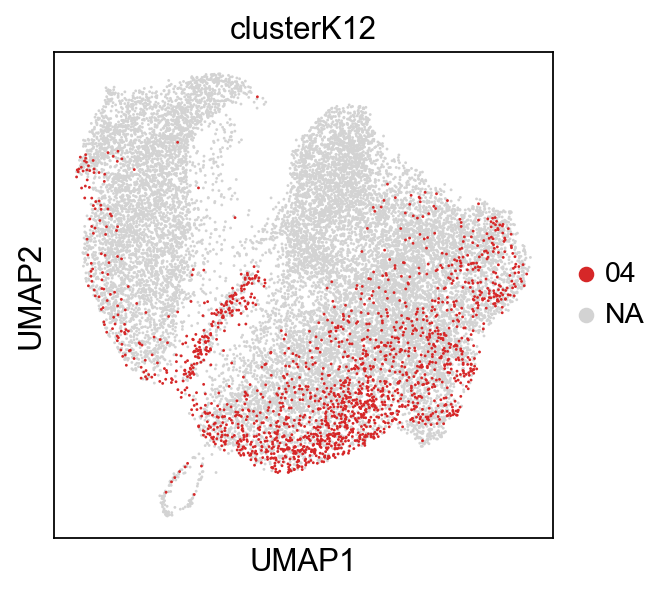

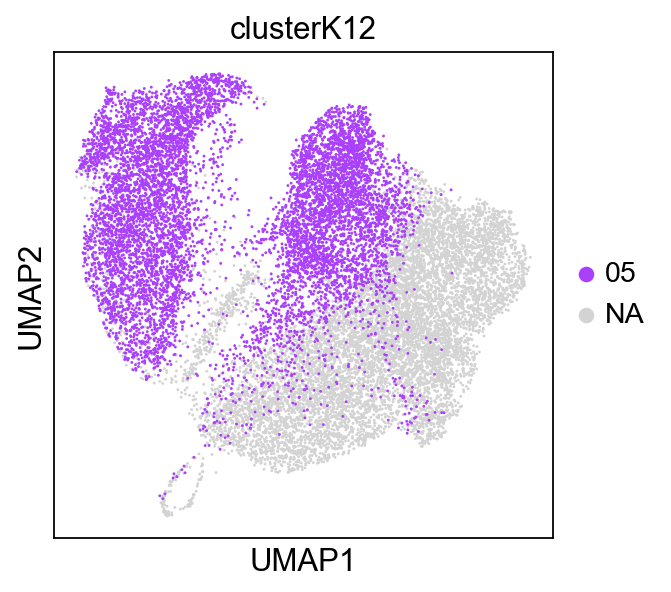

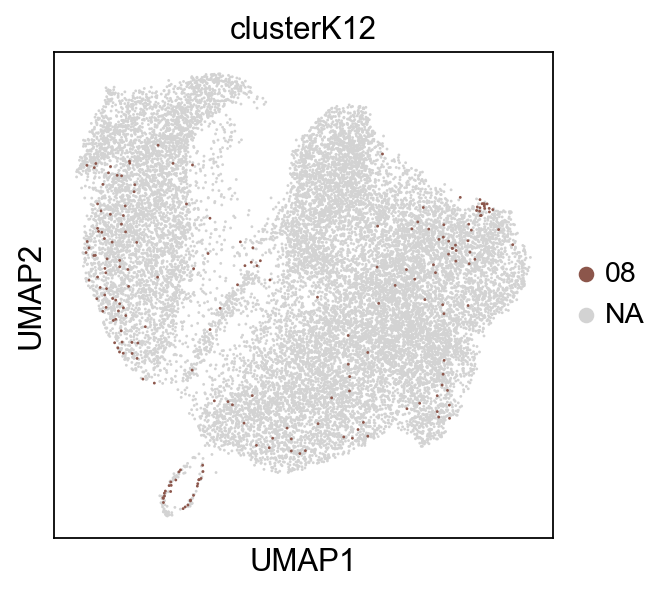

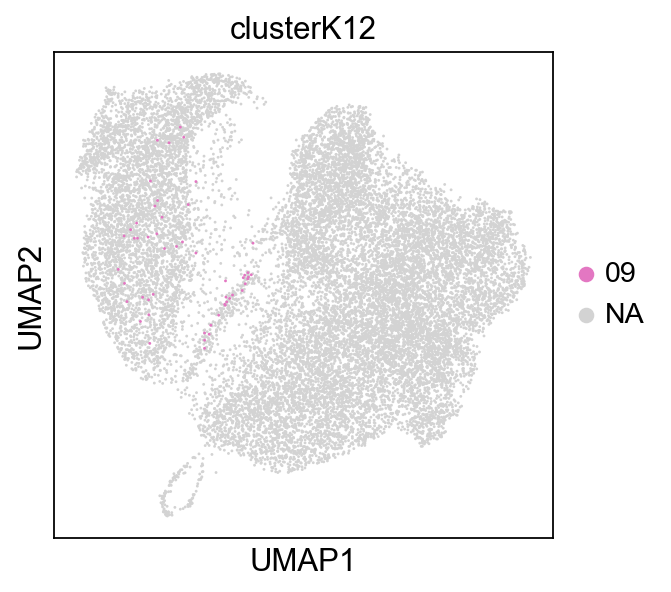

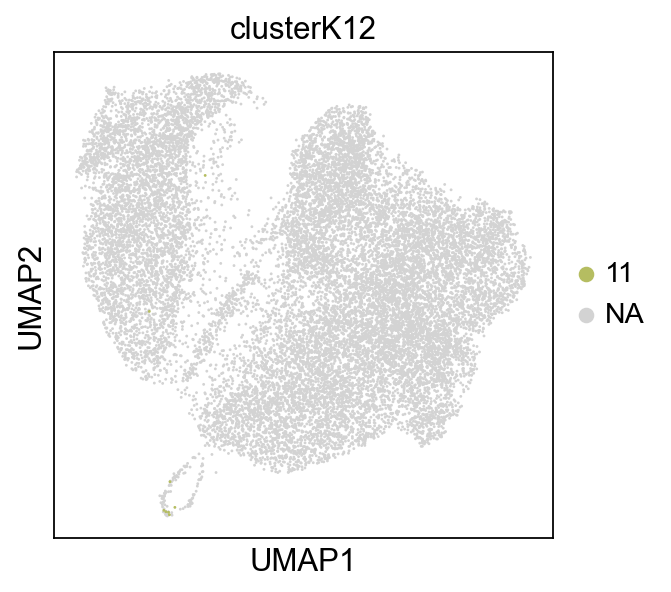

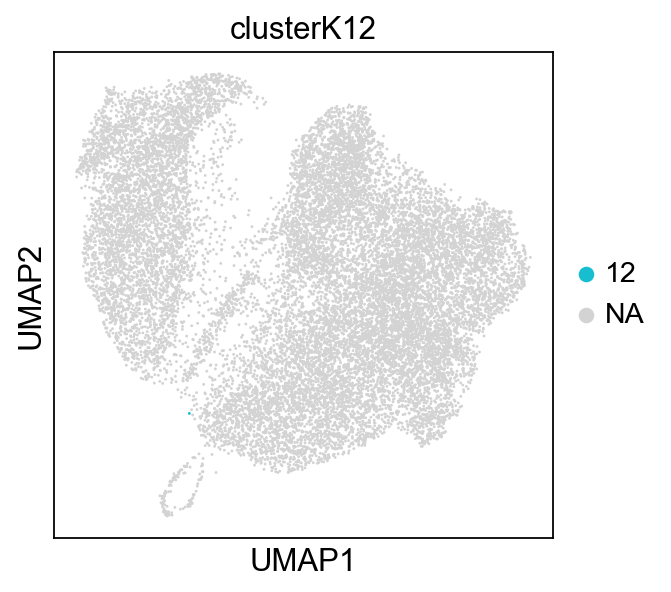

In [97]:
for x in adata_log_ordered.obs.clusterK12.cat.categories:
    sc.pl.umap(adata_log_ordered,color=['clusterK12'], groups=[x])

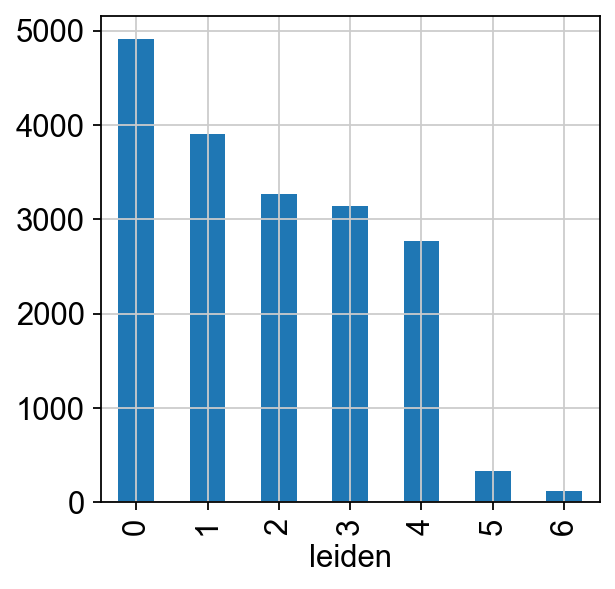

In [98]:
 cell_proportion_df = adata_log_ordered.obs.leiden.value_counts().T.plot(kind='bar', stacked=True, legend=False)

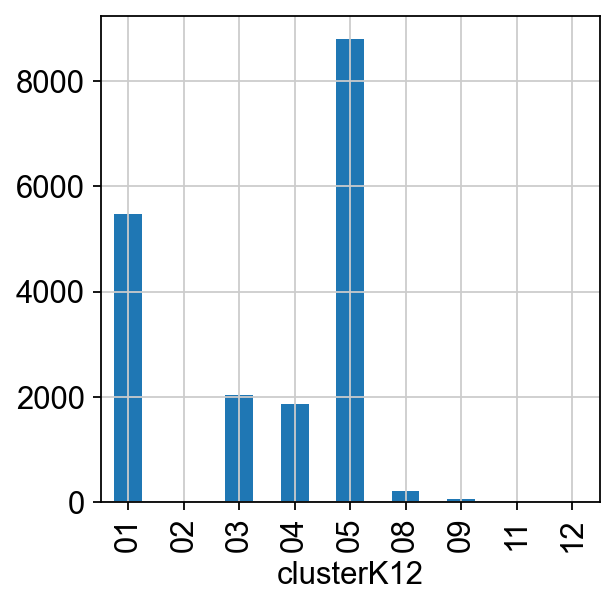

In [99]:
 cell_proportion_df = adata_log_ordered.obs.clusterK12.value_counts(sort=False).T.plot(kind='bar', stacked=True, legend=False)

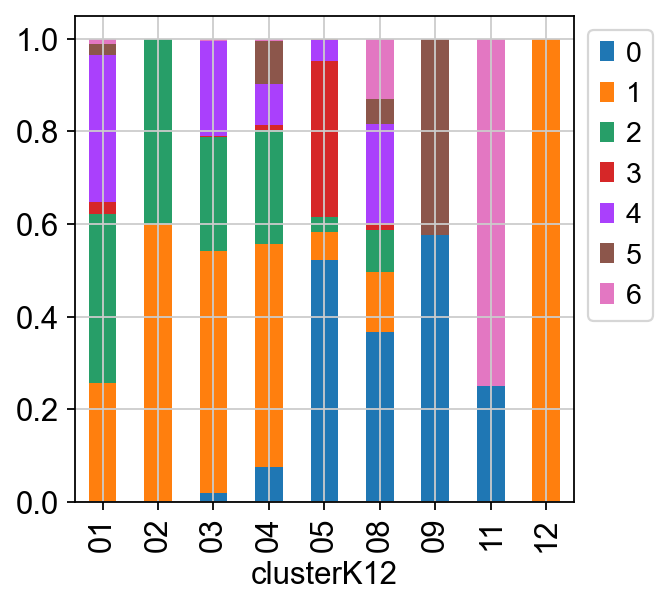

In [100]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [101]:
results_binary = logreg.predict(adata_log_ordered.X)
probs_binary = logreg.predict_proba(adata_log_ordered.X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,03,0.001433,5.418349e-06,0.991255,0.002048,0.002825,0.000071,0.000179,0.001377,0.000004,0.000234,0.000210,0.000360,0.991255
1,05,0.000220,5.524657e-08,0.000139,0.000010,0.999244,0.000002,0.000034,0.000057,0.000009,0.000024,0.000170,0.000091,0.999244
2,05,0.000082,6.626201e-05,0.001922,0.000613,0.990161,0.000035,0.000353,0.001286,0.000142,0.001335,0.001596,0.002410,0.990161
3,04,0.376809,4.880885e-06,0.002902,0.605638,0.000382,0.000134,0.001222,0.010103,0.000027,0.000409,0.000650,0.001719,0.605638
4,05,0.000876,6.377789e-04,0.008180,0.003706,0.945538,0.000103,0.002041,0.013190,0.008619,0.003005,0.006854,0.007250,0.945538
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18451,01,0.867251,2.060807e-05,0.000553,0.125422,0.000116,0.000021,0.000411,0.005151,0.000059,0.000241,0.000259,0.000496,0.867251
18452,05,0.002377,5.094866e-07,0.000529,0.000093,0.995022,0.000020,0.000128,0.000094,0.000504,0.000239,0.000494,0.000498,0.995022
18453,05,0.000935,1.141644e-04,0.004433,0.000362,0.968574,0.000071,0.001027,0.004406,0.011856,0.001662,0.004145,0.002414,0.968574
18454,04,0.161026,6.751020e-03,0.031455,0.604947,0.003410,0.000604,0.007487,0.156473,0.002759,0.006581,0.005648,0.012859,0.604947


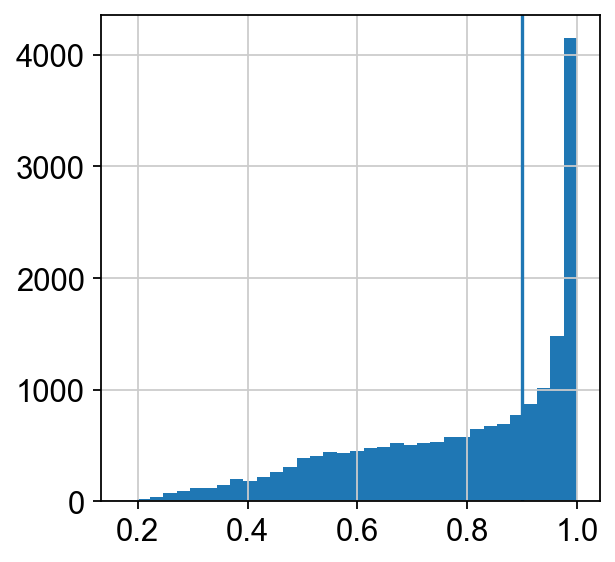

In [102]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto')
plt.axvline(x=0.9)

In [103]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high
0,0.17-0.54,0.172,0.540
1,0.54-0.68,0.540,0.677
2,0.68-0.8,0.677,0.797
3,0.8-0.89,0.797,0.891
4,0.89-0.96,0.891,0.958
5,0.96-0.99,0.958,0.990
6,0.99-1.0,0.990,1.000


In [104]:
cutoff = 0.8
adata_log_ordered.obs['clusterK12_stringent'] = 'other'
adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % y for y in results_df_binary[[x+1 for x in range(0,12)]].idxmax(axis=1)[np.array(results_df_binary['highest_prob'] >= cutoff)].to_numpy()]

/tmp/ipykernel_3157407/4020989001.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % y for y in results_df_binary[[x+1 for x in

In [105]:
adata_log_ordered.obs['clusterK12_stringent']

AAACCCAAGTTCTCTT-1-shNfkb1_lane1       03
AAACCCAGTGCGGATA-1-shNfkb1_lane1       05
AAACGAAAGGACCCAA-1-shNfkb1_lane1       05
AAACGAACAGACGGAT-1-shNfkb1_lane1    other
AAACGAAGTAACAGGC-1-shNfkb1_lane1       05
                                    ...  
TTTGTTGGTCGTGATT-1-IkbSR-Cre           01
TTTGTTGGTGGCCTCA-1-IkbSR-Cre           05
TTTGTTGTCCCGTTCA-1-IkbSR-Cre           05
TTTGTTGTCGAGCCTG-1-IkbSR-Cre        other
TTTGTTGTCTAGCAAC-1-IkbSR-Cre           01
Name: clusterK12_stringent, Length: 18456, dtype: object

In [106]:
adata_log_ordered.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

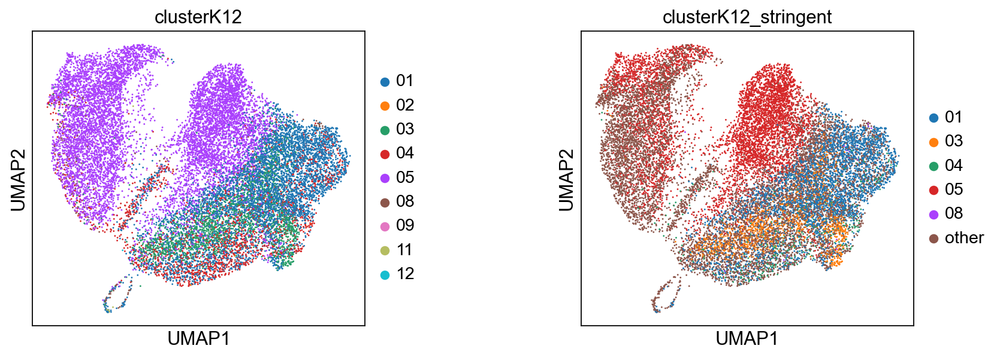

In [107]:
sc.pl.umap(adata_log_ordered, color=['clusterK12', 'clusterK12_stringent'], wspace=0.5)

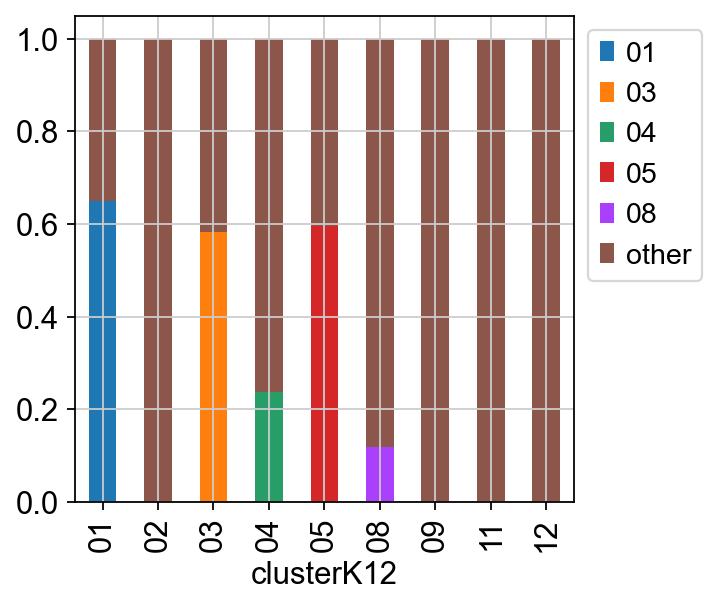

In [108]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['clusterK12_stringent'],adata_log_ordered.obs['clusterK12'],normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

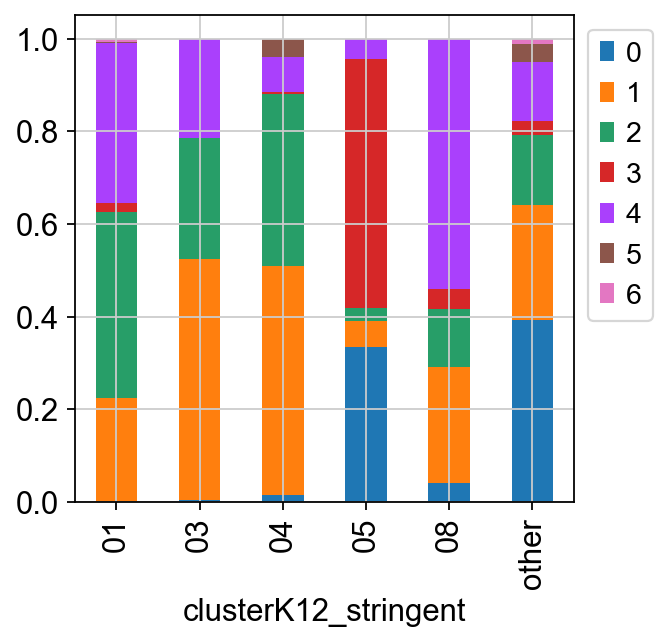

In [109]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

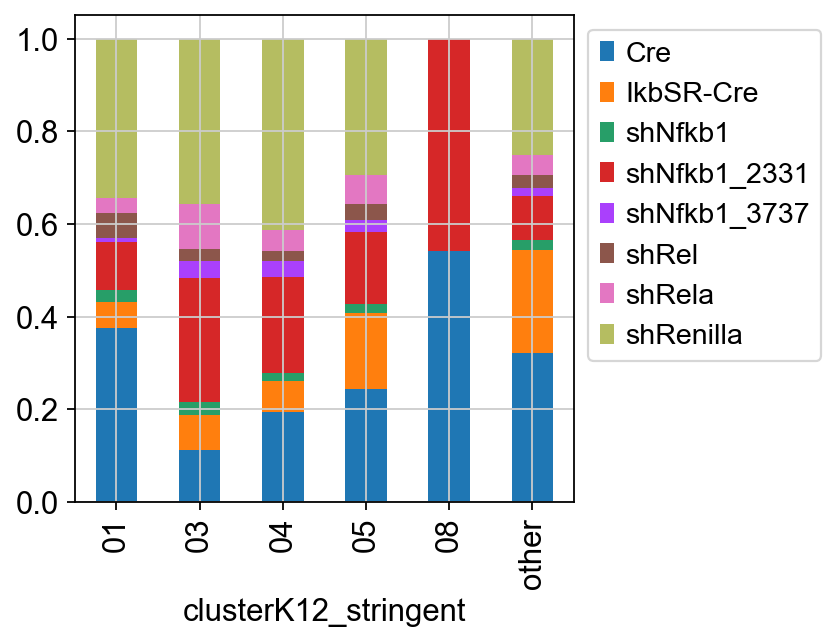

In [110]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Group'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

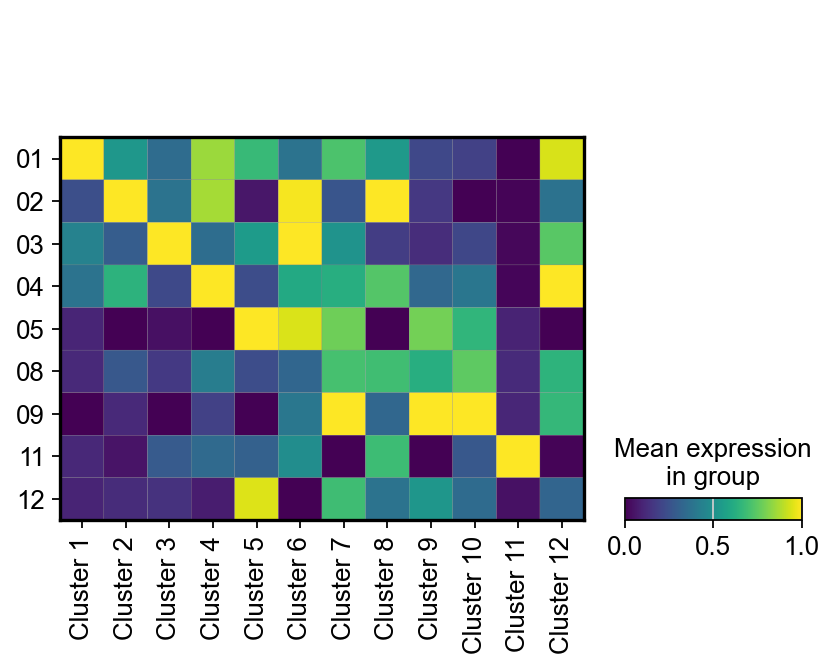

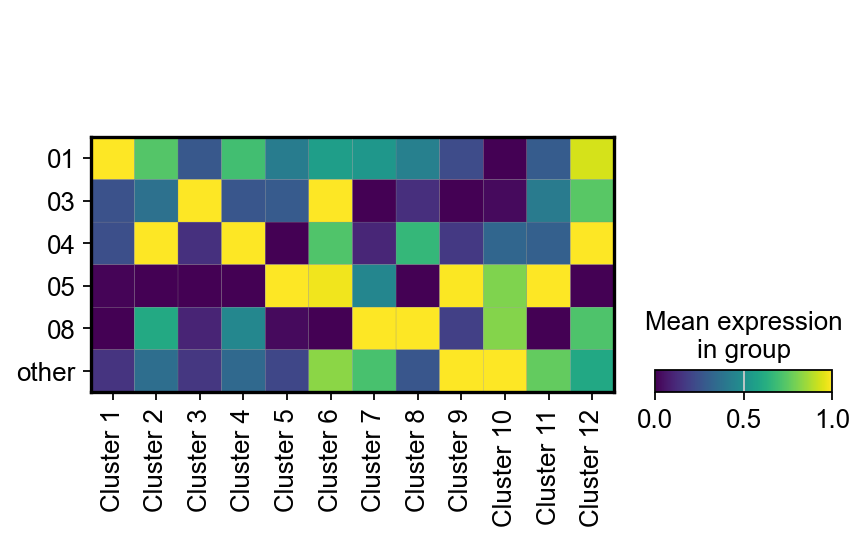

In [111]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']
#cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Cluster 1'],adata_log_ordered.obs['clusterK12']).T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12', standard_scale='var')
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12_stringent', standard_scale='var')

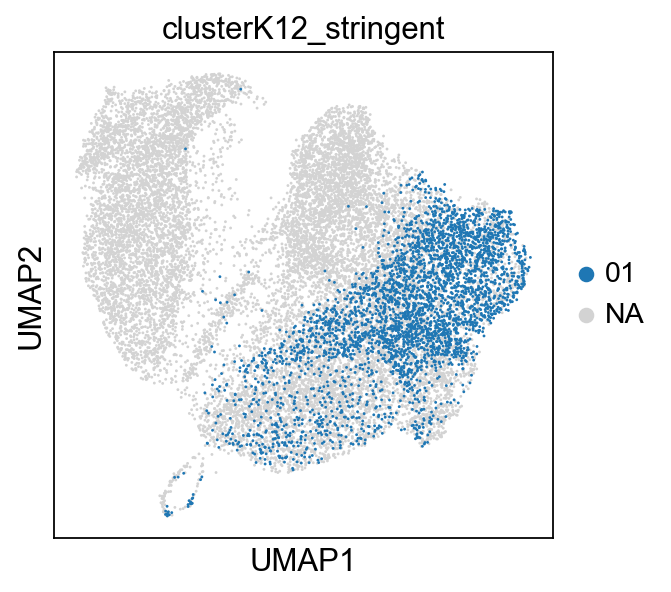

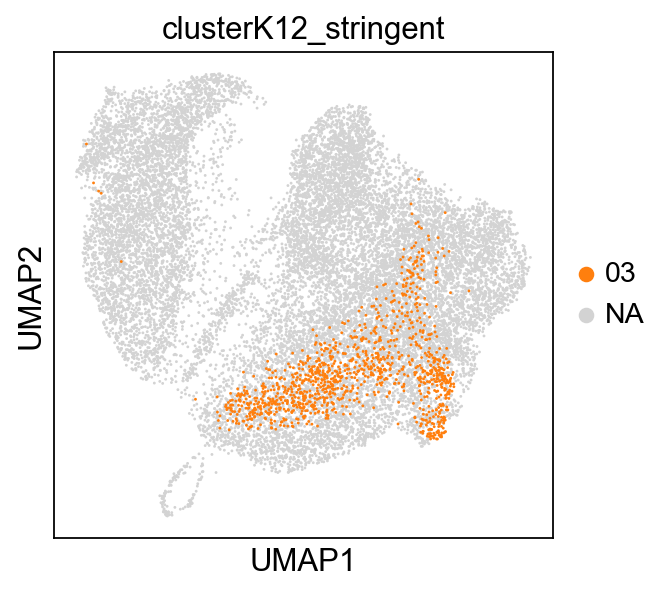

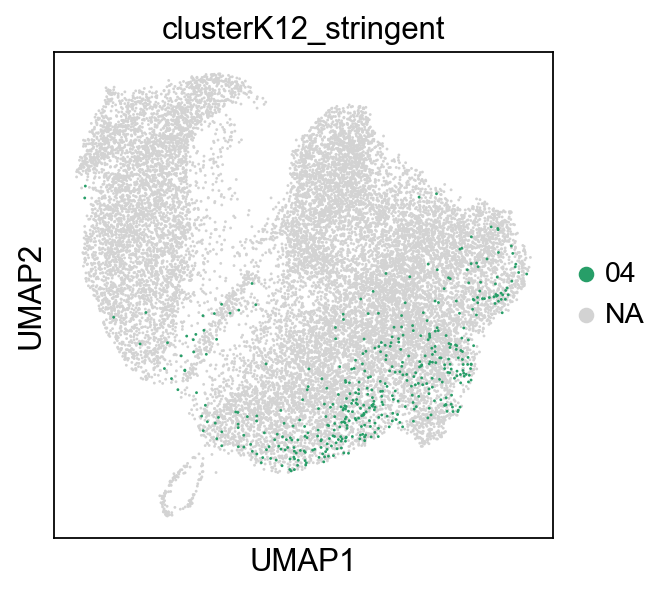

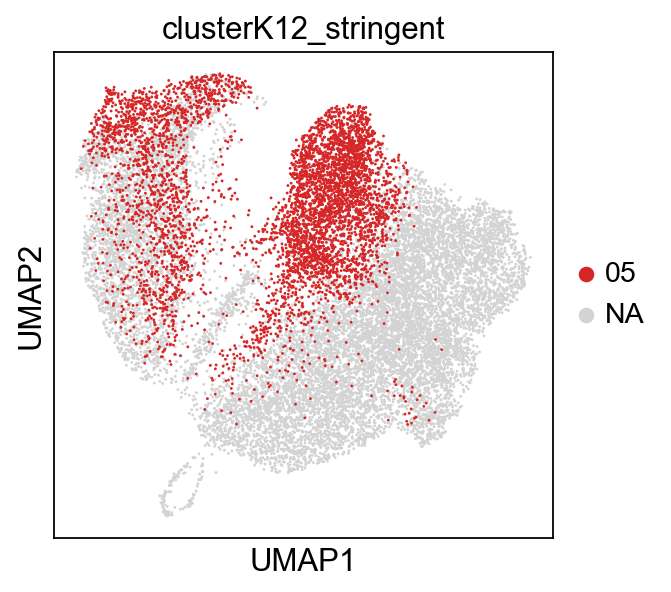

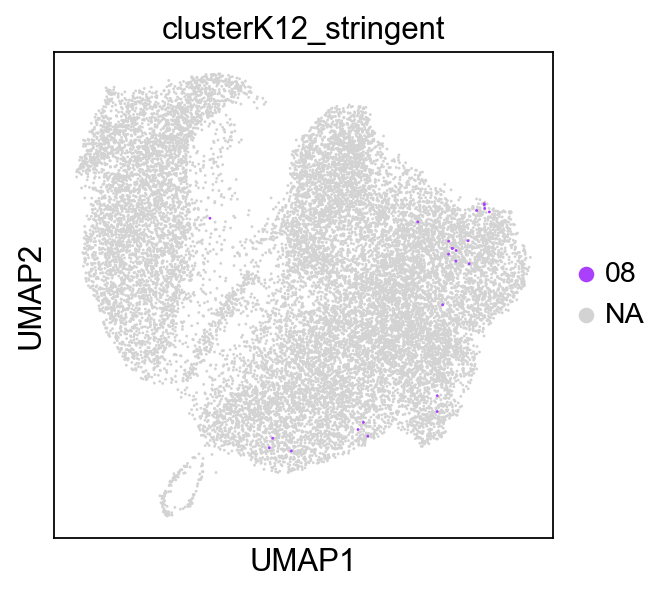

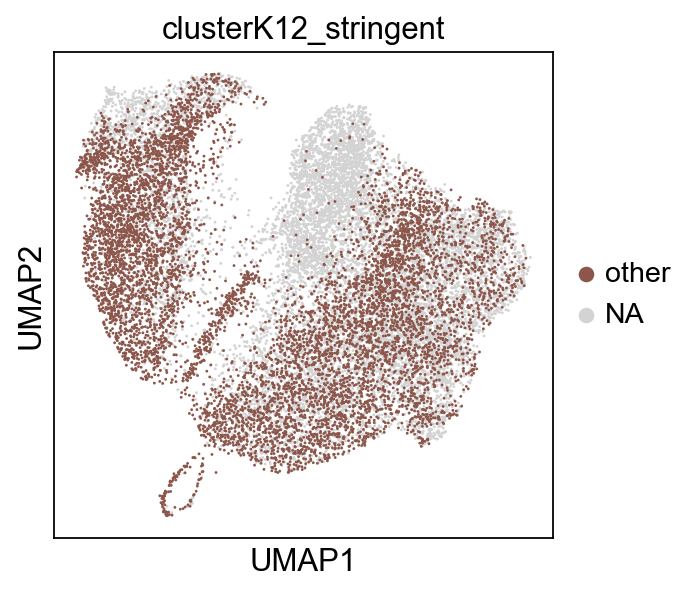

In [112]:
for x in adata_log_ordered.obs.clusterK12_stringent.cat.categories:
    # skip if NA
    sc.pl.umap(adata_log_ordered, color='clusterK12_stringent', groups=[x])

In [114]:
adata_log_ordered.obs.clusterK12.value_counts()

clusterK12
05    8805
01    5476
03    2043
04    1865
08     201
09      52
11       8
02       5
12       1
Name: count, dtype: int64

In [115]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']
#sc.pl.violin(adata_log_ordered, cancerCell, groupby='clusterK12')

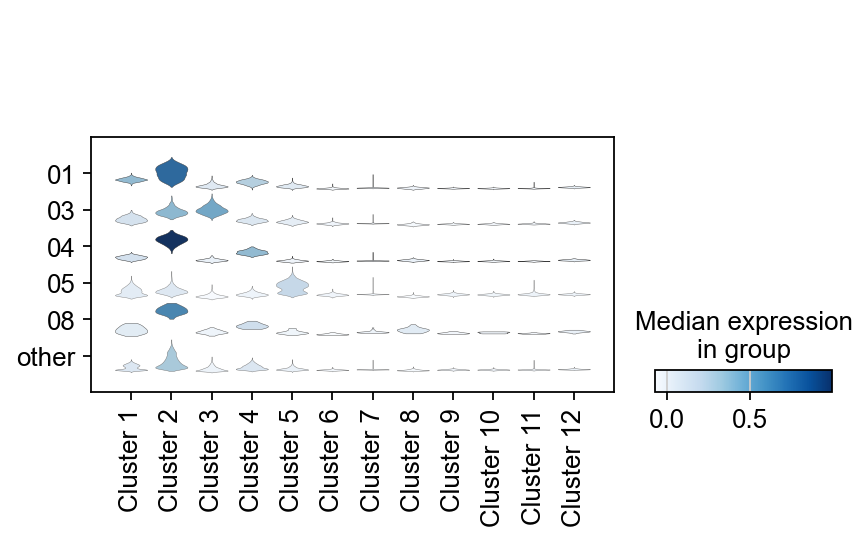

In [116]:
sc.pl.stacked_violin(adata_log_ordered, cancerCell, groupby='clusterK12_stringent')

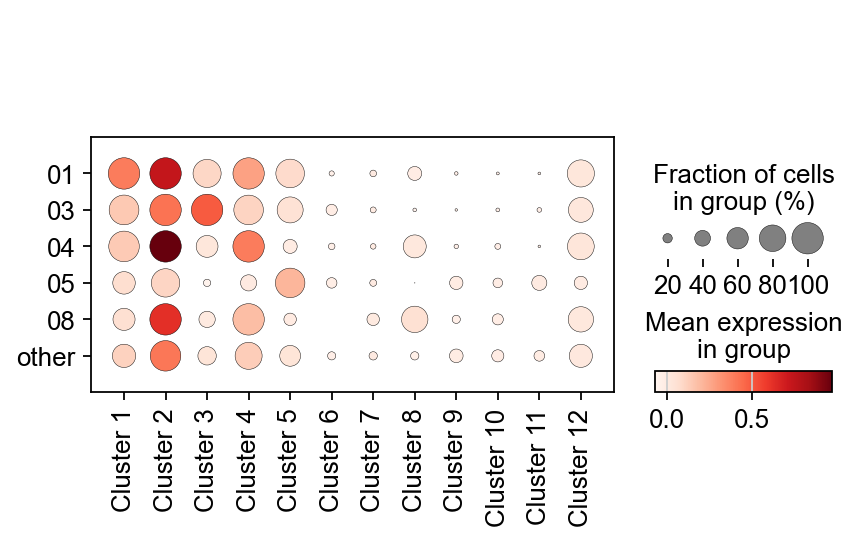

In [117]:
sc.pl.dotplot(adata_log_ordered, cancerCell, groupby='clusterK12_stringent')

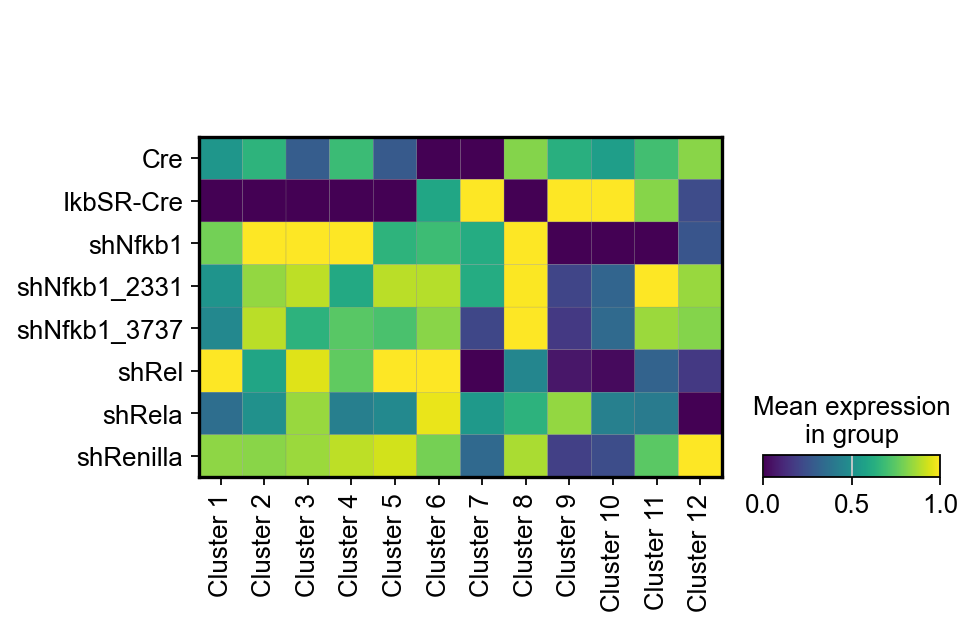

In [118]:
sc.pl.matrixplot(adata_log_ordered, cancerCell, groupby='Group',standard_scale='var')

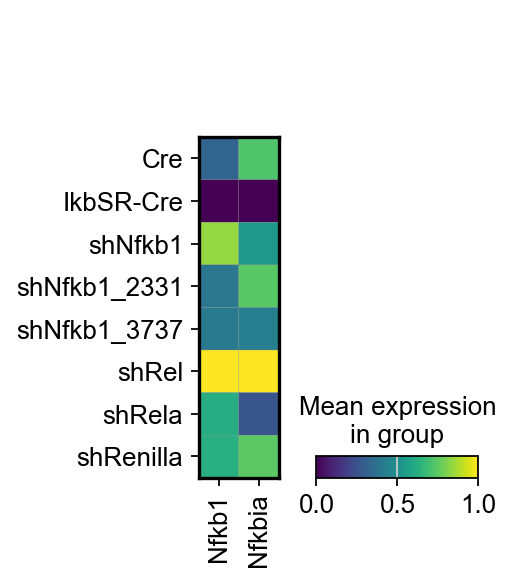

In [119]:
sc.pl.matrixplot(adata_log_ordered, ['Nfkb1','Nfkbia'], groupby='Group',standard_scale='var')

In [120]:
adata.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')
adata.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

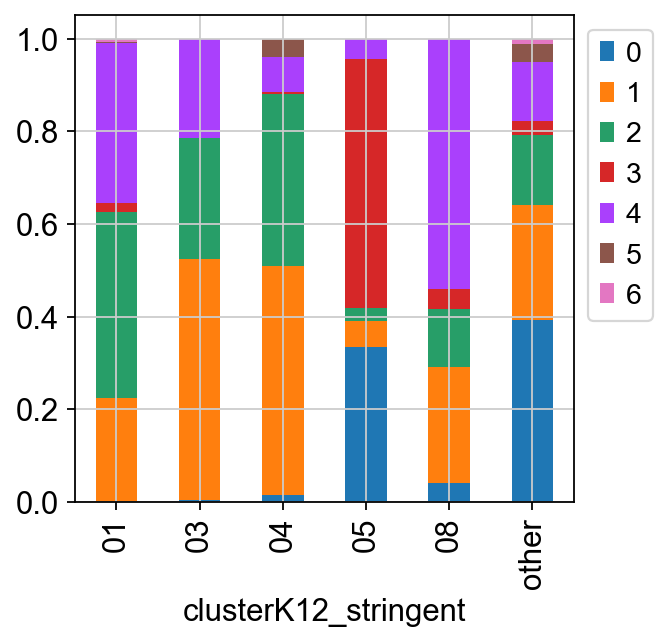

In [121]:
 cell_proportion_df = pd.crosstab(adata.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

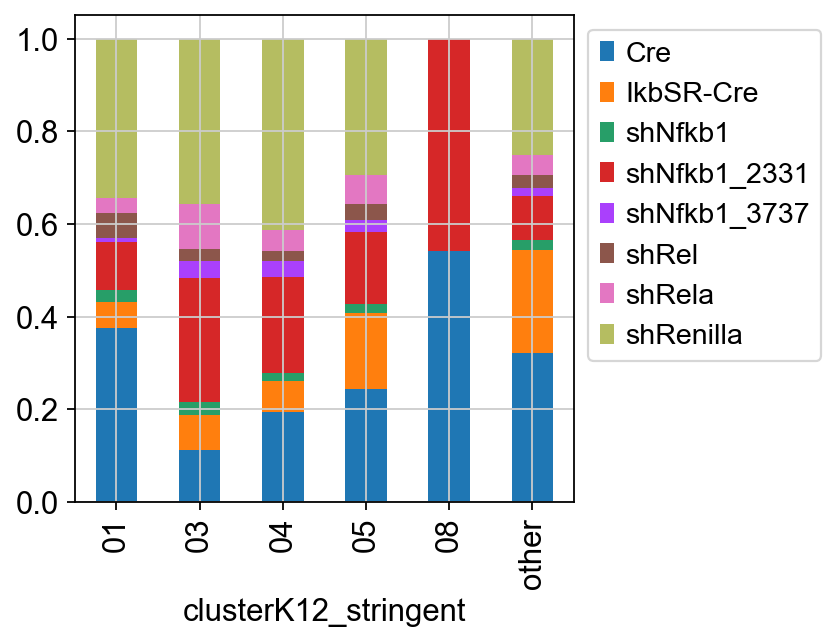

In [122]:
 cell_proportion_df = pd.crosstab(adata.obs['Group'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

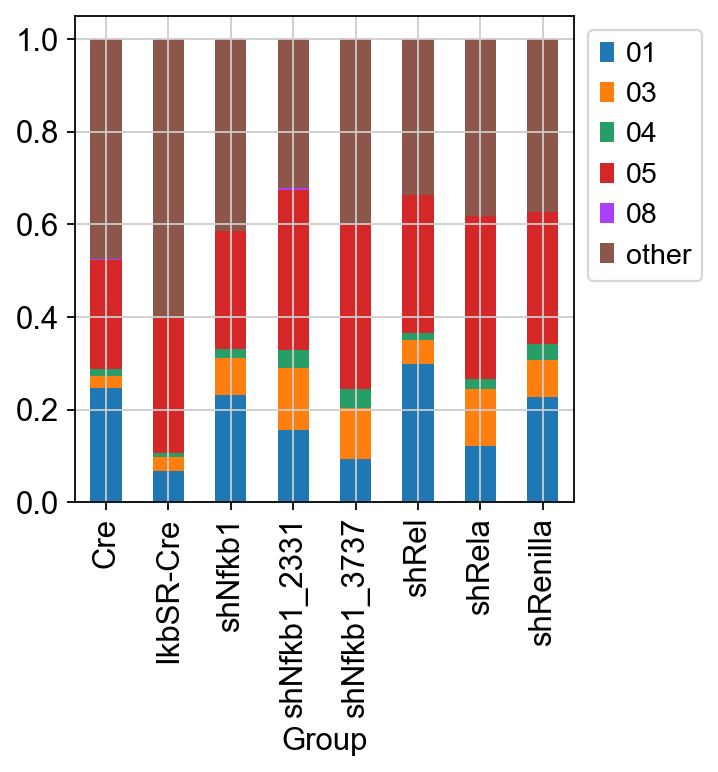

In [123]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12_stringent'],adata_log_ordered.obs['Group'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

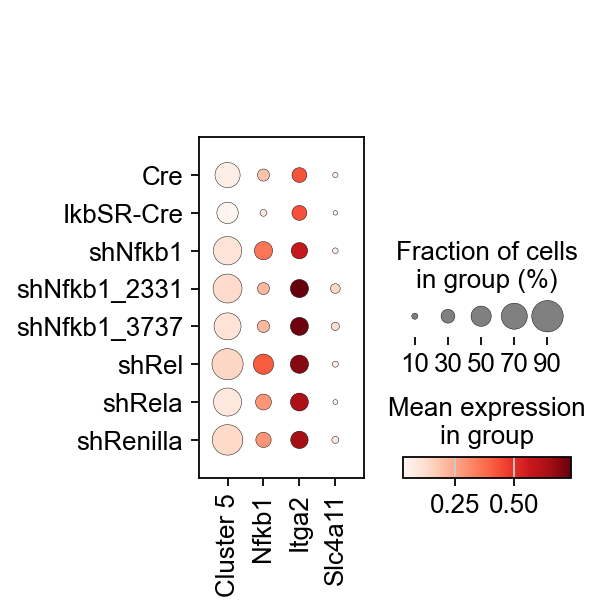

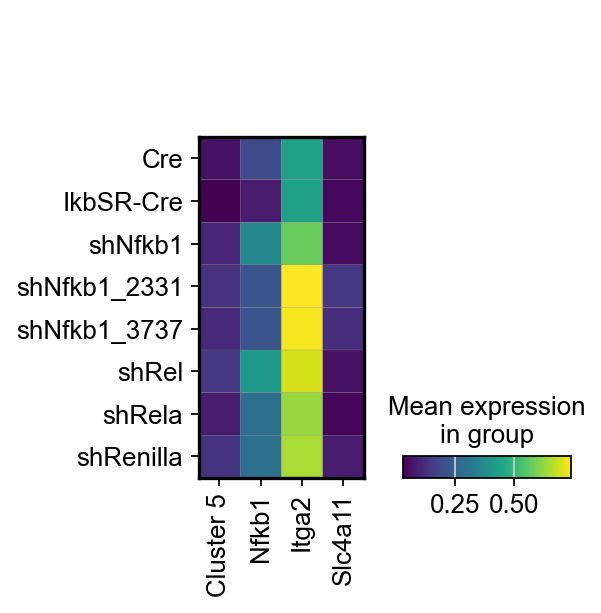

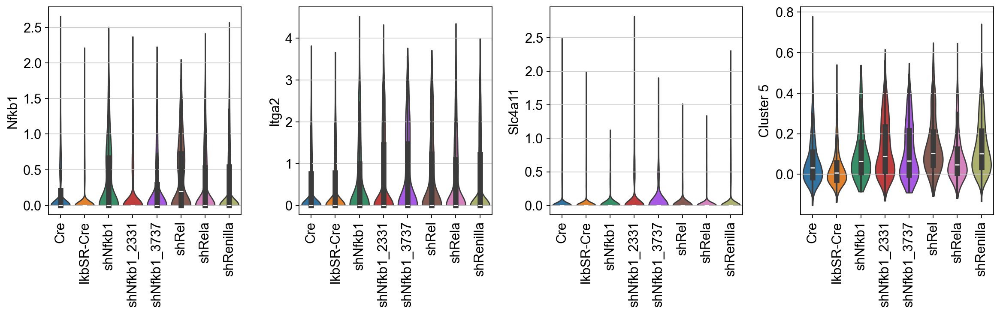

In [124]:
sc.pl.dotplot(adata, ['Cluster 5', 'Nfkb1', 'Itga2','Slc4a11'], groupby='Group')
sc.pl.matrixplot(adata, ['Cluster 5', 'Nfkb1', 'Itga2','Slc4a11'], groupby='Group')
sc.pl.violin(adata, ['Nfkb1', 'Itga2','Slc4a11','Cluster 5'], groupby='Group', stripplot=False, inner='box', rotation=90)

In [125]:
adata.obs.shRNA.value_counts()

shRNA
shRenilla    1022
2117          518
2118          201
shRela        191
shRel         169
Name: count, dtype: int64

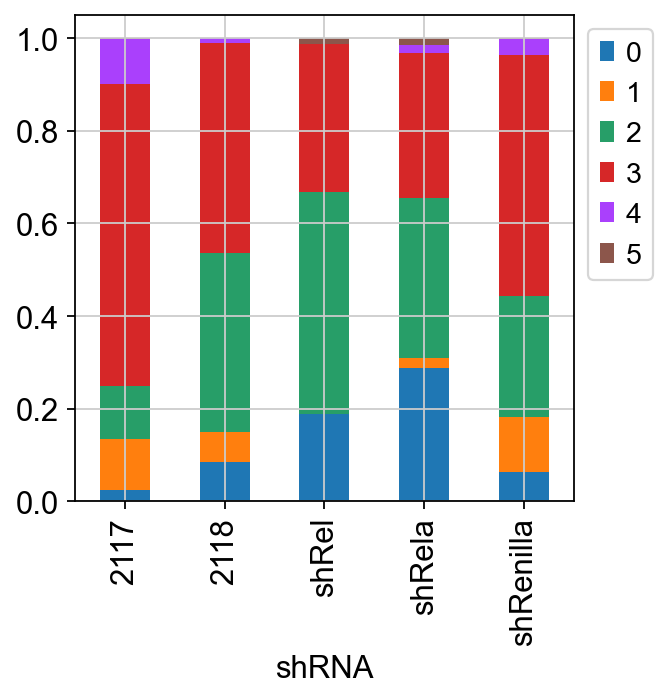

In [126]:
 cell_proportion_df = pd.crosstab(adata.obs['leiden'],adata.obs['shRNA'],normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

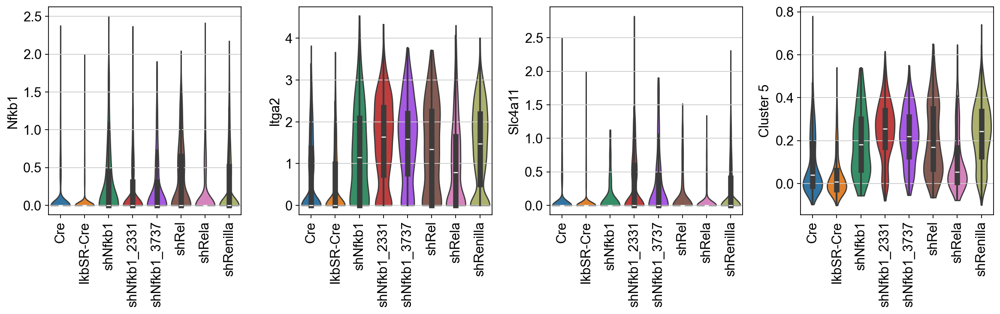

In [127]:
sc.pl.violin(adata[adata.obs.clusterK12.isin(['05']),:], ['Nfkb1', 'Itga2','Slc4a11','Cluster 5'], groupby='Group', stripplot=False, inner='box', rotation=90)

## Look at subsampled data

In [128]:
adata_subsampled = adata[adata.obs.shRNA.isin(['2118']), :].concatenate(
    sc.pp.subsample(adata[adata.obs.shRNA.isin(['shRenilla']),:], copy=True, n_obs=201),
    sc.pp.subsample(adata[adata.obs.shRNA.isin(['2117']),:], copy=True,n_obs=201))

/tmp/ipykernel_3157407/3110733135.py:1: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata_subsampled = adata[adata.obs.shRNA.isin(['2118']), :].concatenate(


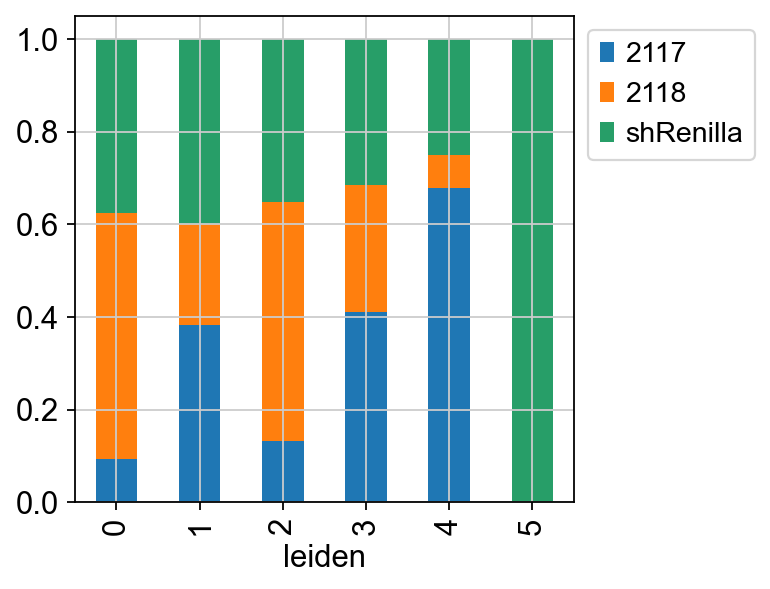

In [129]:
 cell_proportion_df = pd.crosstab(adata_subsampled.obs['shRNA'],adata_subsampled.obs['leiden'],normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

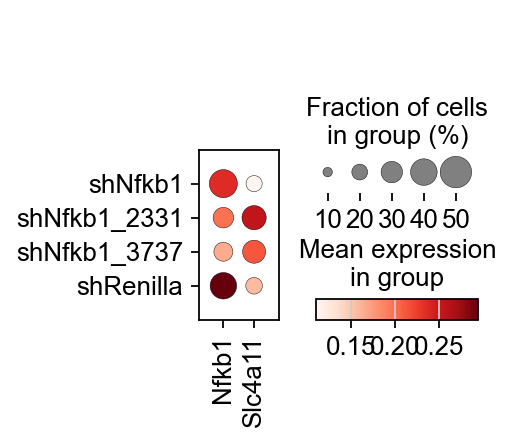

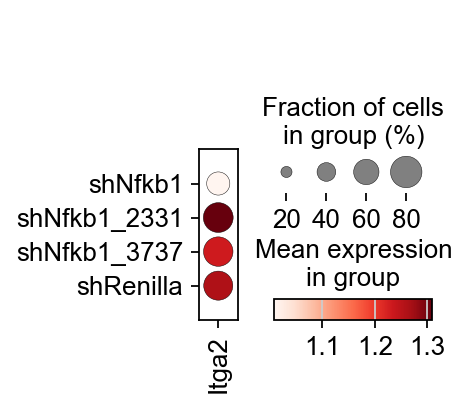

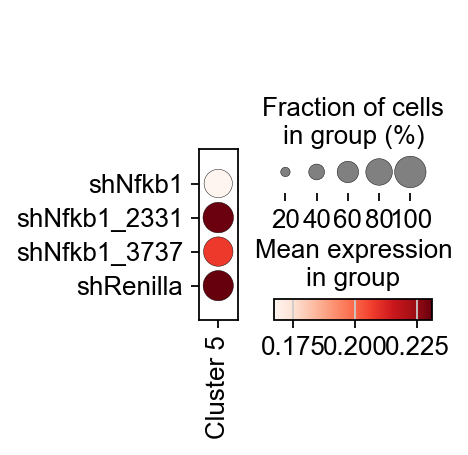

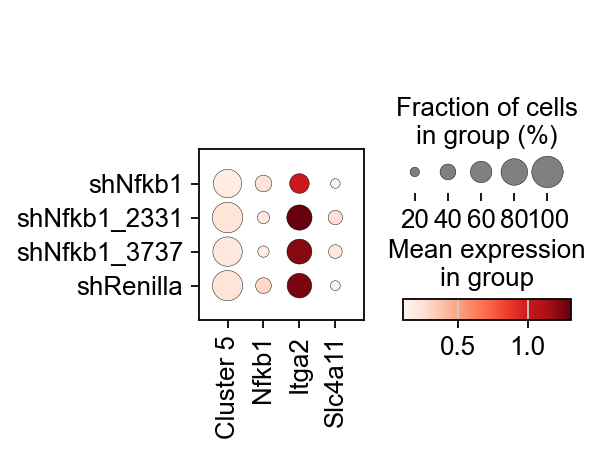

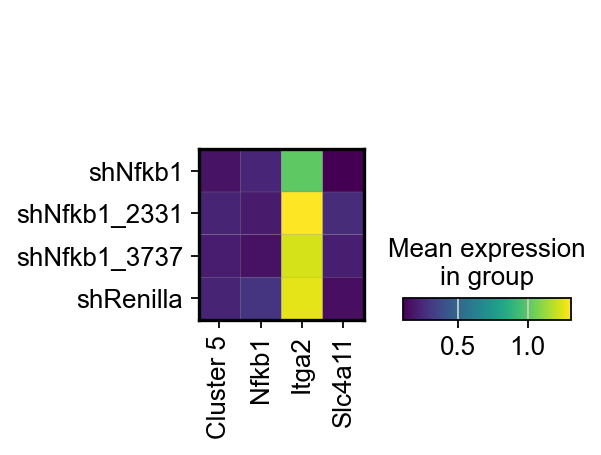

In [130]:
sc.pl.dotplot(adata_subsampled, ['Nfkb1', 'Slc4a11'], groupby='Group')
sc.pl.dotplot(adata_subsampled, ['Itga2'], groupby='Group')
sc.pl.dotplot(adata_subsampled, ['Cluster 5'], groupby='Group')
sc.pl.dotplot(adata_subsampled, ['Cluster 5', 'Nfkb1', 'Itga2','Slc4a11'], groupby='Group')
sc.pl.matrixplot(adata_subsampled, ['Cluster 5', 'Nfkb1', 'Itga2','Slc4a11'], groupby='Group')

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    1494 total control genes are used. (0:00:00)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    1397 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    1186 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    1495 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    1195 total control genes are used. (0:00:00)
computing score 'Cluster 6'
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    1594 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: added
    'Cluster 7', score of gene set (adata.obs).
    1094 total control genes are u

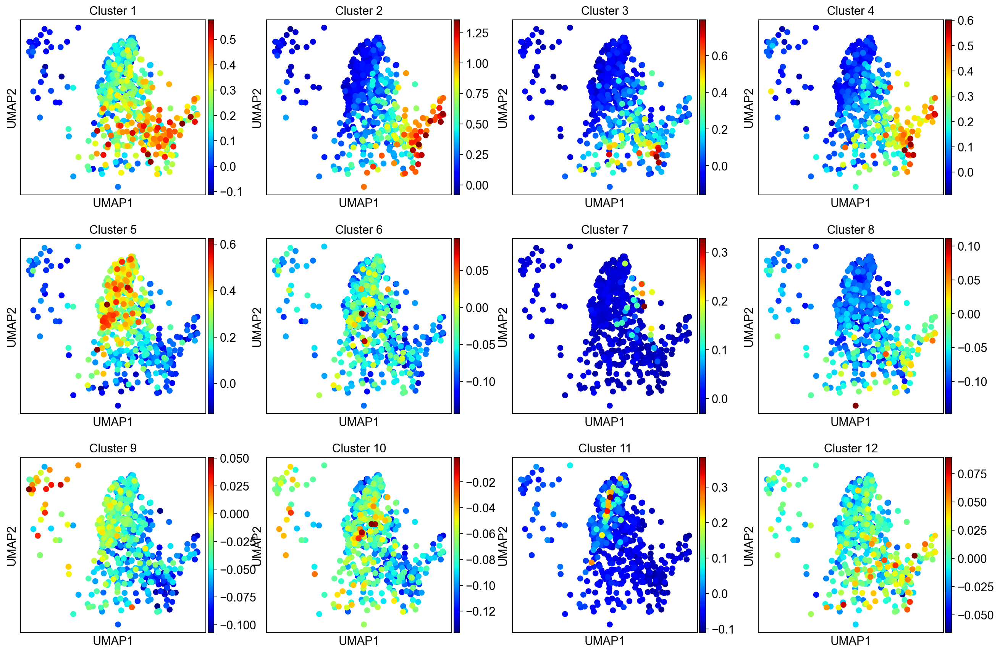

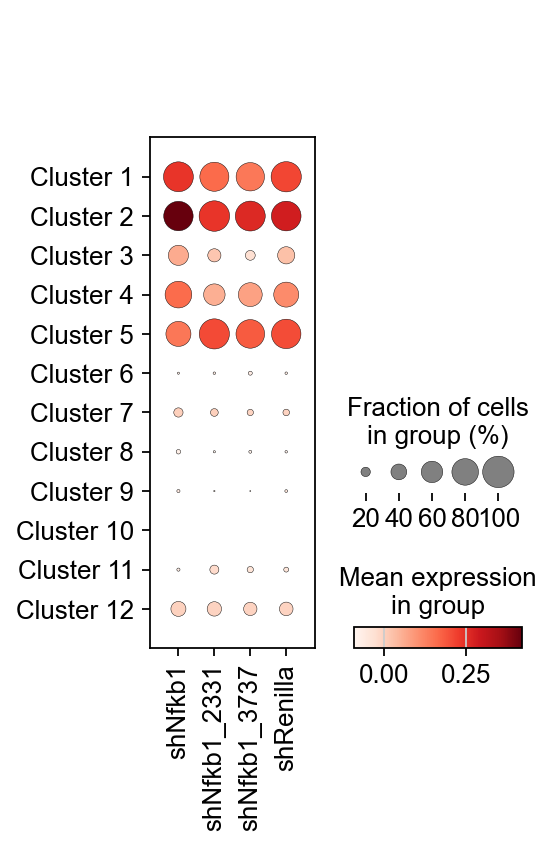

In [131]:
(clusters, clusterkeys, HPCS) = resetClusters('cell2020')
scoreAndPlot(adata_subsampled, groupby='Group',numgenes=100)

In [132]:
adata_subsampled.obs.shRNA.value_counts()

shRNA
2117         201
2118         201
shRenilla    201
Name: count, dtype: int64

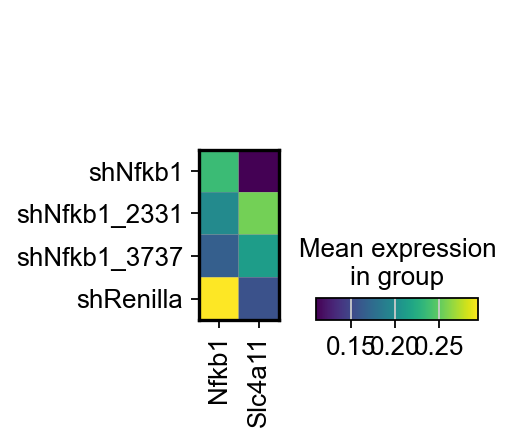

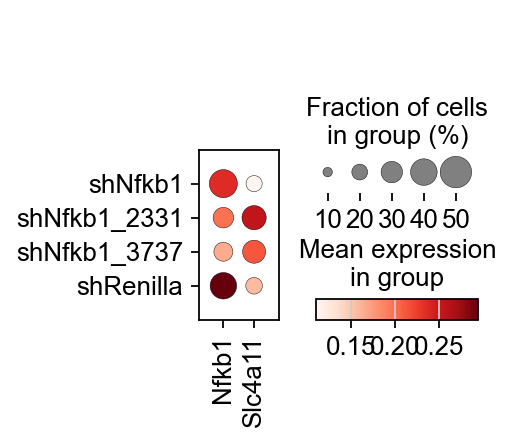

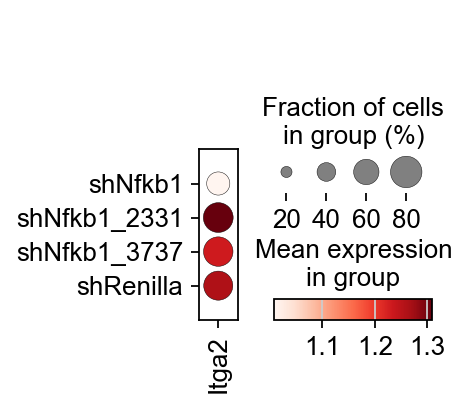

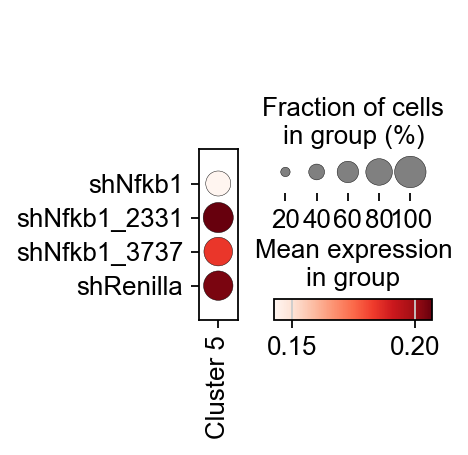

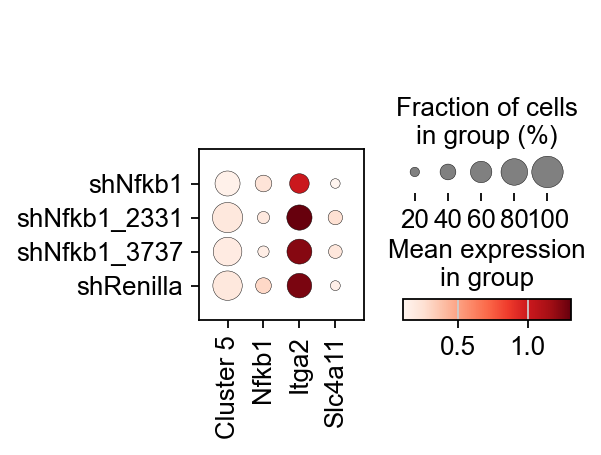

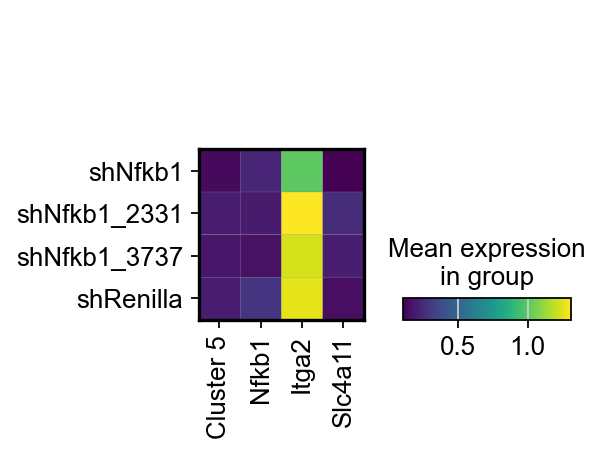

In [133]:
sc.pl.matrixplot(adata_subsampled, ['Nfkb1', 'Slc4a11'], groupby='Group')
sc.pl.dotplot(adata_subsampled, ['Nfkb1', 'Slc4a11'], groupby='Group')
sc.pl.dotplot(adata_subsampled, ['Itga2'], groupby='Group')
sc.pl.dotplot(adata_subsampled, ['Cluster 5'], groupby='Group')
sc.pl.dotplot(adata_subsampled, ['Cluster 5', 'Nfkb1', 'Itga2','Slc4a11'], groupby='Group')
sc.pl.matrixplot(adata_subsampled, ['Cluster 5', 'Nfkb1', 'Itga2','Slc4a11'], groupby='Group')

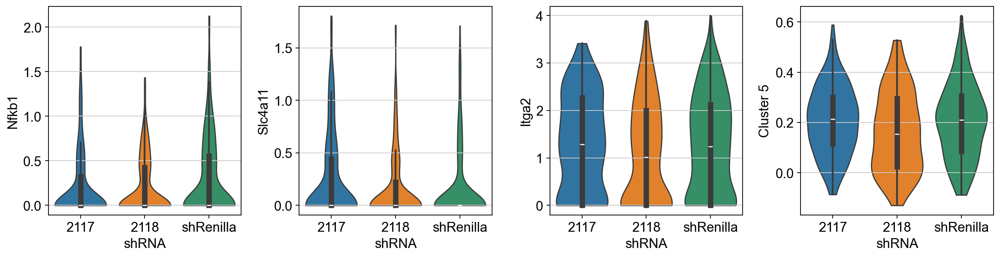

In [134]:
sc.pl.violin(adata_subsampled, ['Nfkb1', 'Slc4a11', 'Itga2', 'Cluster 5', ], groupby='shRNA', stripplot=False, inner='box')

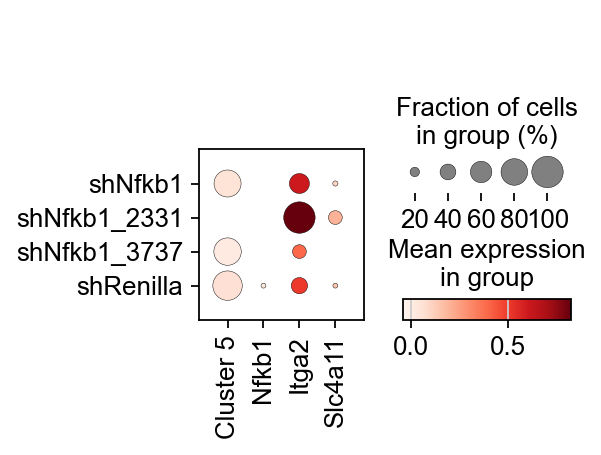

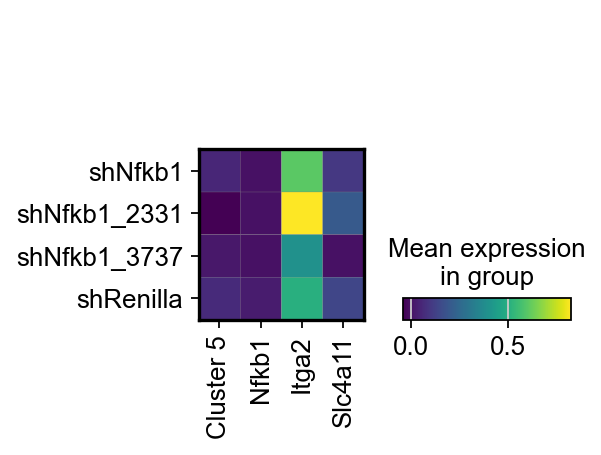

/home/chanj2/part2a/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[f"{value_to_plot}_colors"] = colors_list


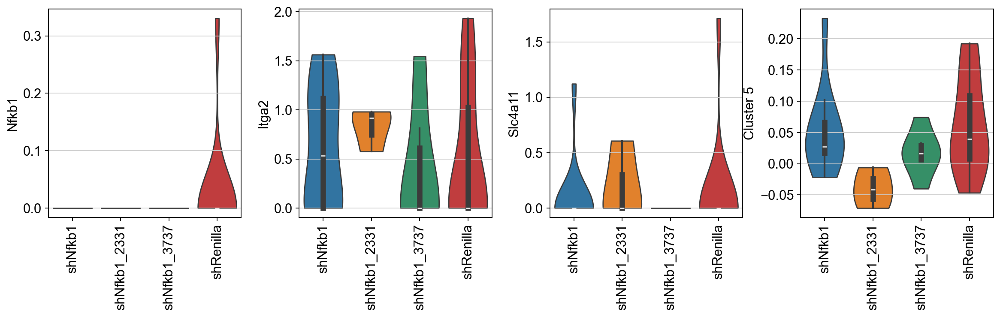

In [135]:
sc.pl.dotplot(adata_subsampled[adata_subsampled.obs.leiden.isin(['0']),:], ['Cluster 5', 'Nfkb1', 'Itga2','Slc4a11'], groupby='Group')
sc.pl.matrixplot(adata_subsampled[adata_subsampled.obs.leiden.isin(['0']),:], ['Cluster 5', 'Nfkb1', 'Itga2','Slc4a11'], groupby='Group')
sc.pl.violin(adata_subsampled[adata_subsampled.obs.leiden.isin(['0']),:], ['Nfkb1', 'Itga2','Slc4a11','Cluster 5'], groupby='Group', stripplot=False, inner='box', rotation=90)

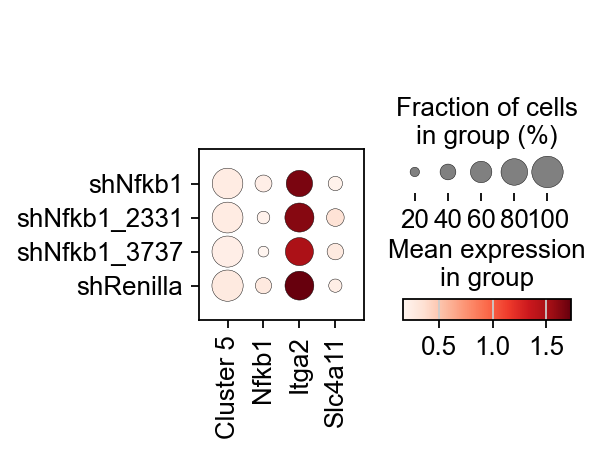

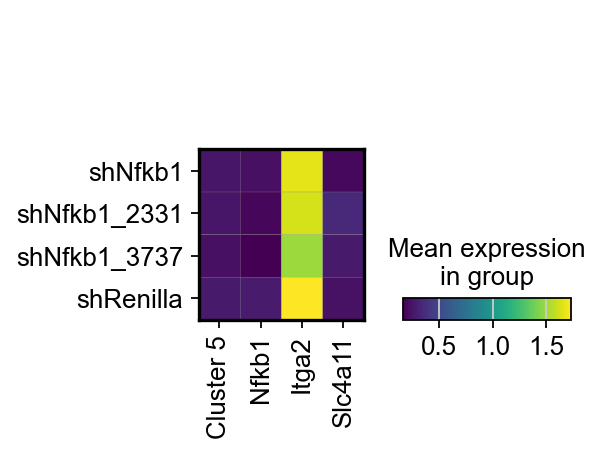

/home/chanj2/part2a/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[f"{value_to_plot}_colors"] = colors_list


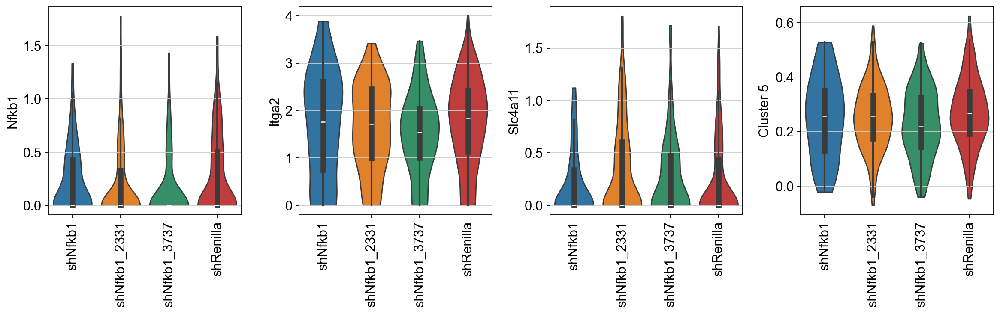

In [136]:
sc.pl.dotplot(adata_subsampled[adata_subsampled.obs.clusterK12.isin(['05']),:], ['Cluster 5', 'Nfkb1', 'Itga2','Slc4a11'], groupby='Group')
sc.pl.matrixplot(adata_subsampled[adata_subsampled.obs.clusterK12.isin(['05']),:], ['Cluster 5', 'Nfkb1', 'Itga2','Slc4a11'], groupby='Group')
sc.pl.violin(adata_subsampled[adata_subsampled.obs.clusterK12.isin(['05']),:], ['Nfkb1', 'Itga2','Slc4a11','Cluster 5'], groupby='Group', stripplot=False, inner='box', rotation=90)

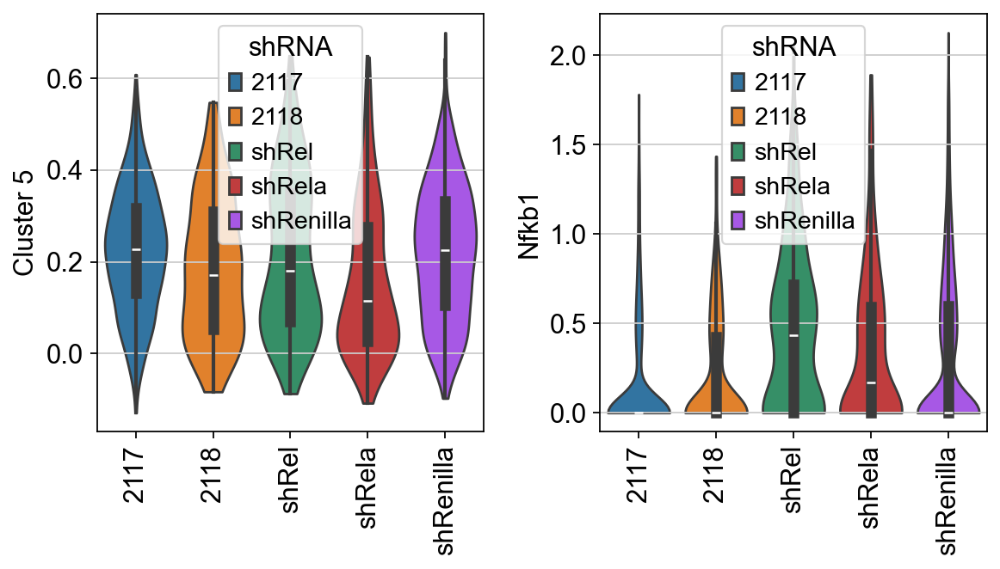

In [138]:
sc.pl.violin(adata, ['Cluster 5', 'Nfkb1'], groupby='shRNA', stripplot=False, inner='box', rotation=90)

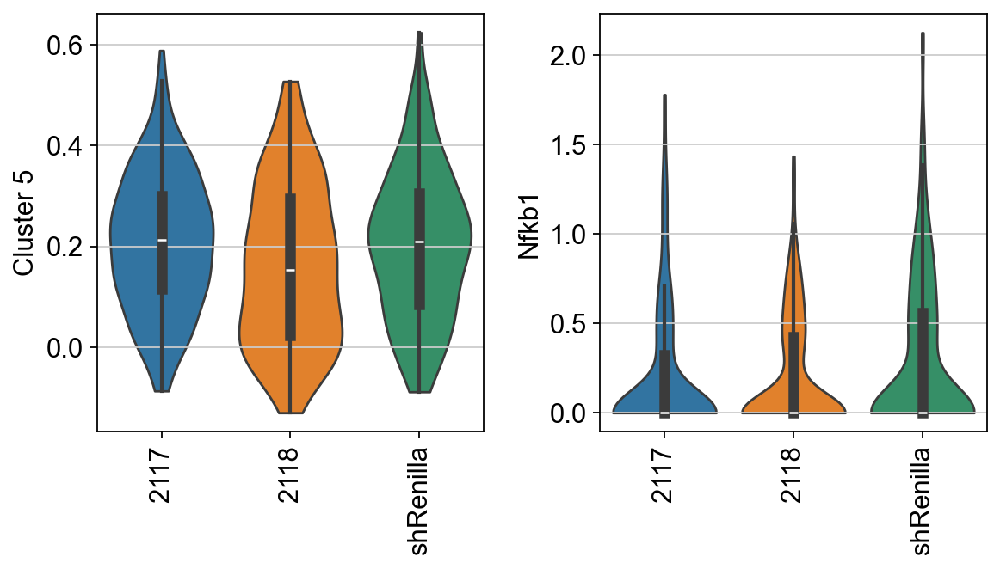

In [139]:
sc.pl.violin(adata_subsampled, ['Cluster 5', 'Nfkb1'], groupby='shRNA', stripplot=False, inner='box',rotation=90)

In [140]:
adata.obs.Group.value_counts()

Group
Cre             5412
shRenilla       5384
IkbSR-Cre       2955
shNfkb1_2331    2366
shRela           923
shRel            640
shNfkb1          398
shNfkb1_3737     378
Name: count, dtype: int64

## Cre Cells

In [144]:
adata2 = adata[adata.obs.index.isin(CreCells),:]
adata2.obs.Group.value_counts()

Group
shRenilla       1191
shNfkb1_2331     643
shRela           200
shRel            169
shNfkb1_3737     111
shNfkb1          107
IkbSR-Cre         69
Cre                4
Name: count, dtype: int64

computing score 'Cluster 1'


/home/chanj2/part2a/lib/python3.11/site-packages/scanpy/tools/_score_genes.py:165: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[score_name] = pd.Series(


    finished: added
    'Cluster 1', score of gene set (adata.obs).
    1293 total control genes are used. (0:00:00)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    1494 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    1294 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    1388 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    1296 total control genes are used. (0:00:00)
computing score 'Cluster 6'
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    1891 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: added
    'Cluster 7', score of gene set (adata.obs).
    1096 total control genes are used. (0:00:00)
computing sco

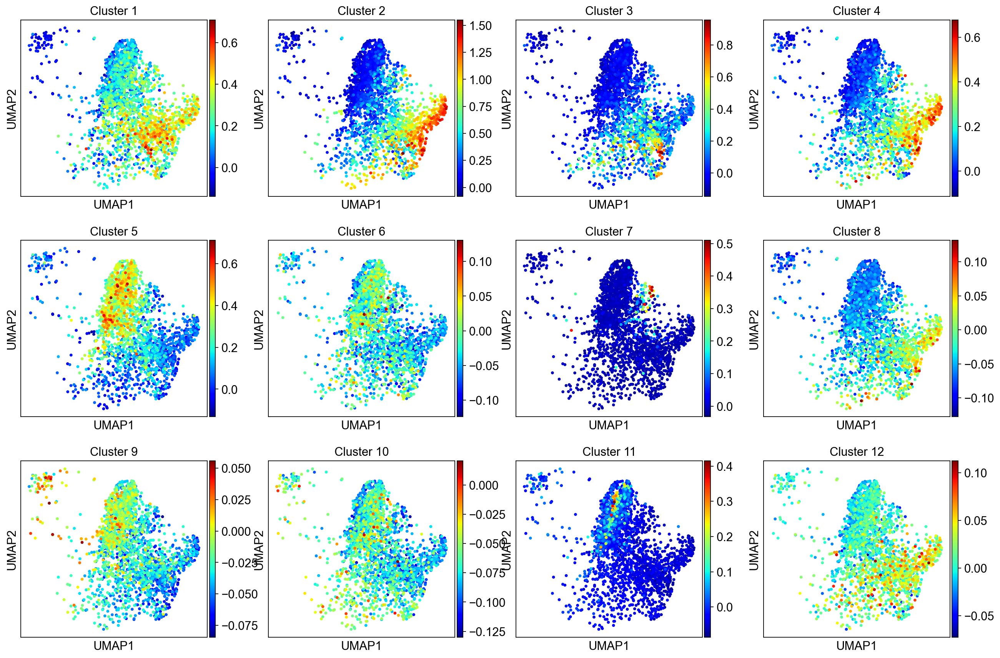

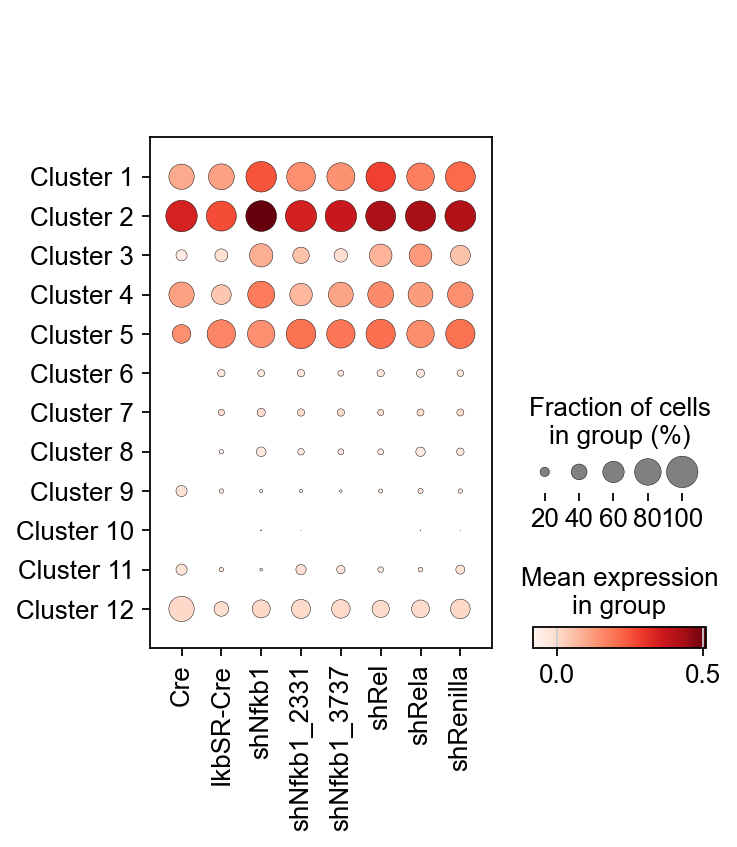

In [145]:
(clusters, clusterkeys, HPCS) = resetClusters('cell2020')
scoreAndPlot(adata2, groupby='Group',numgenes=100)

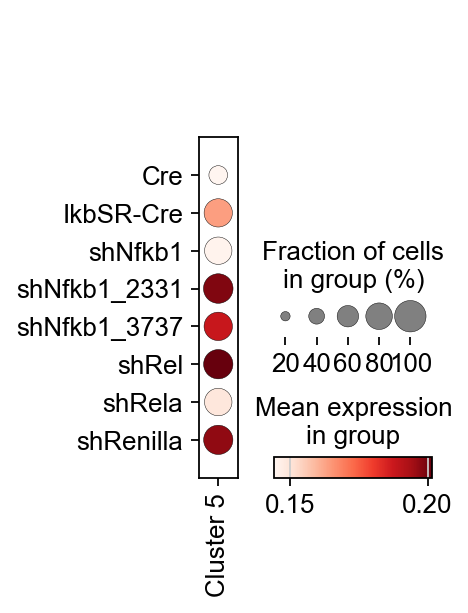

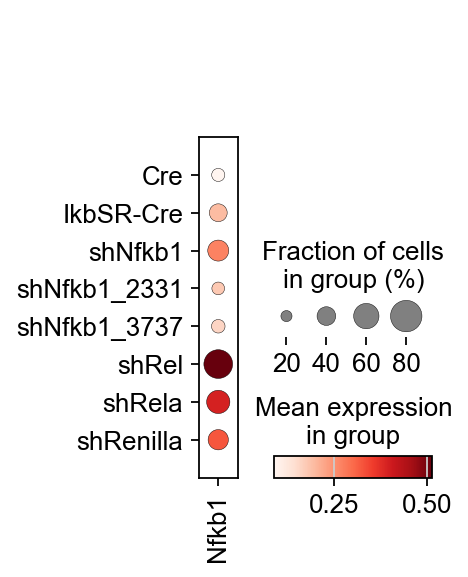

In [146]:
sc.pl.dotplot(adata2, ['Cluster 5'], groupby='Group')
sc.pl.dotplot(adata2, ['Nfkb1'], groupby='Group') #,'Slc4a11'

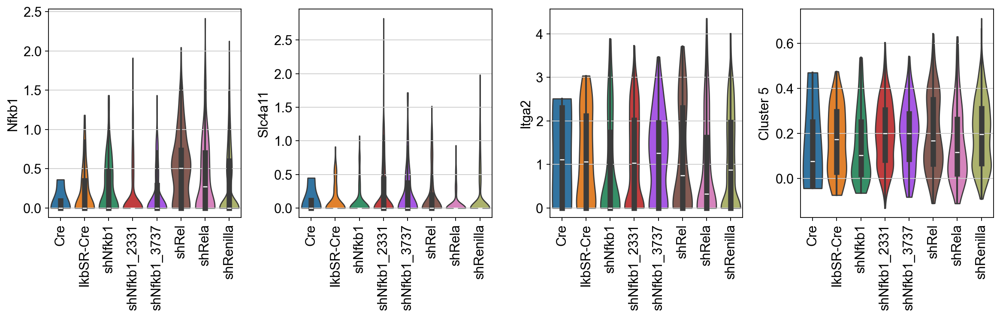

In [147]:
sc.pl.violin(adata2,['Nfkb1','Slc4a11','Itga2','Cluster 5'], groupby='Group',inner='box',stripplot=False, rotation=90)

Look at Cluster 5 cells

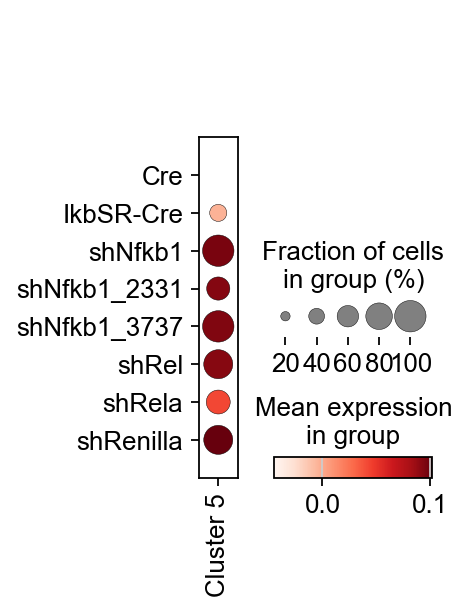

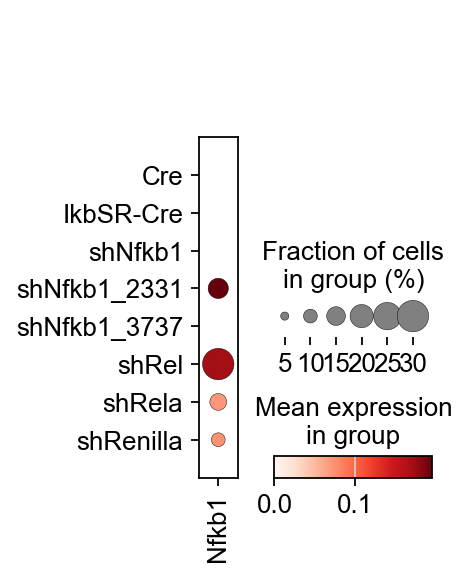

In [148]:
sc.pl.dotplot(adata2[adata2.obs.leiden.isin(['0']),:], ['Cluster 5'], groupby='Group')
sc.pl.dotplot(adata2[adata2.obs.leiden.isin(['0']),:], ['Nfkb1'], groupby='Group') #,'Slc4a11'

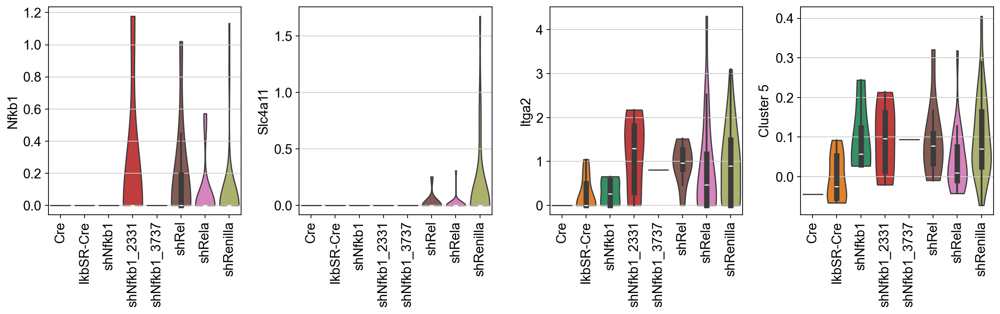

In [149]:
sc.pl.violin(adata2[adata2.obs.leiden.isin(['0']),:],['Nfkb1','Slc4a11','Itga2','Cluster 5'], groupby='Group',inner='box',stripplot=False, rotation=90)

In [150]:
adata2

AnnData object with n_obs × n_vars = 2494 × 30144
    obs: 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'shRen', '2118-Nfkb1', '2117-Nfkb1', 'GFP_count', 'Cre_count', 'shRNA', 'Group', 'shRela', 'shRel', 'batch', 'leiden', 'umap_density_Group', 'umap_density_shRNA', 'Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4', 'Cluster 5', 'Cluster 6', 'Cluster 7', 'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12', 'clusterK12', 'clusterK12_stringent'
    var: 'gene_ids-IkbSR-Cre', 'feature_types-IkbSR-Cre', 'genome-IkbSR-Cre', 'pattern-IkbSR-Cre', 'read-IkbSR-Cre', 'sequence-IkbSR-Cre', 'n_cells-IkbSR-Cre', 'mt-IkbSR-Cre', 'n_cells_by_counts-IkbSR-Cre', 'mean_counts-IkbSR-Cre', 'pct_dropout_by_counts-IkbSR-Cre', 'total_counts-IkbSR-Cre', 'highly_variable-IkbSR-Cre', 'means-IkbSR-Cre', 'dispersions-IkbSR-Cre', 'dispersions_norm-IkbSR-Cre', 'gene_ids-shHairpins', 'feature_types-shHairpins', '

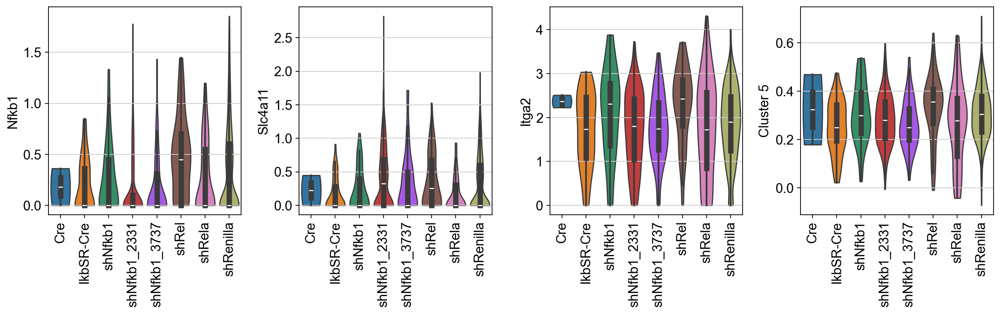

In [151]:
sc.pl.violin(adata2[adata2.obs.clusterK12_stringent.isin(['05']),:],['Nfkb1','Slc4a11','Itga2','Cluster 5'], groupby='Group',inner='box',stripplot=False, rotation=90)

## GFP

In [152]:
adata3 = adata[adata.obs.index.isin(GFPCells),:]
adata3.obs.Group.value_counts()

Group
shRenilla       522
shNfkb1_2331    277
shRela          169
shRel            95
shNfkb1          69
shNfkb1_3737     52
Name: count, dtype: int64

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    1396 total control genes are used. (0:00:00)
computing score 'Cluster 2'


/home/chanj2/part2a/lib/python3.11/site-packages/scanpy/tools/_score_genes.py:165: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[score_name] = pd.Series(


    finished: added
    'Cluster 2', score of gene set (adata.obs).
    1291 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    1186 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    1493 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    1389 total control genes are used. (0:00:00)
computing score 'Cluster 6'
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    1892 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: added
    'Cluster 7', score of gene set (adata.obs).
    1295 total control genes are used. (0:00:00)
computing score 'Cluster 8'
    finished: added
    'Cluster 8', score of gene set (adata.obs).
    1888 total control genes are used. (0:00:00)
computing sco

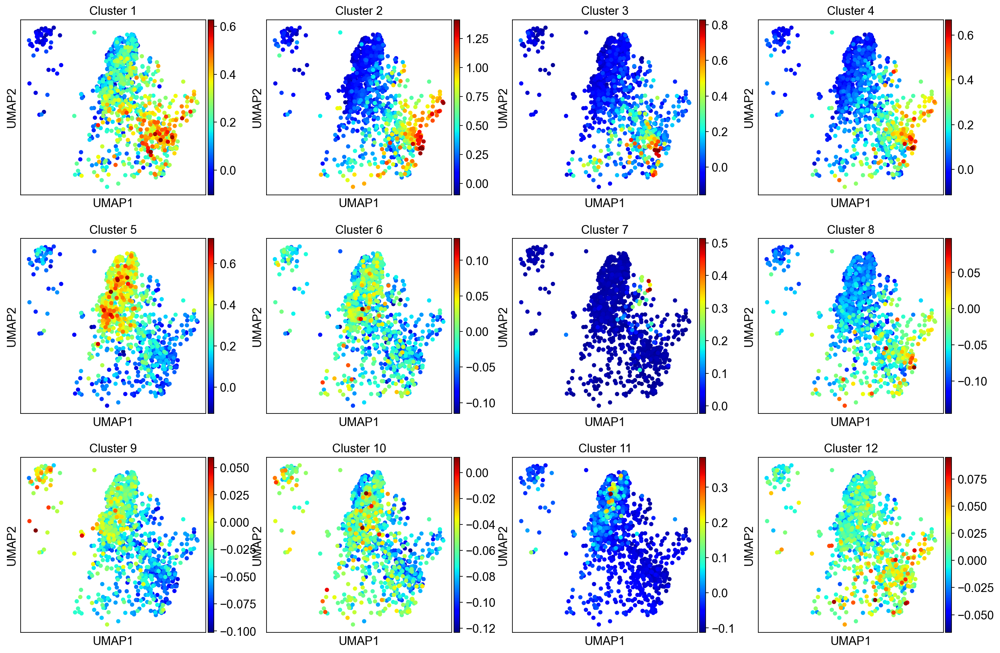

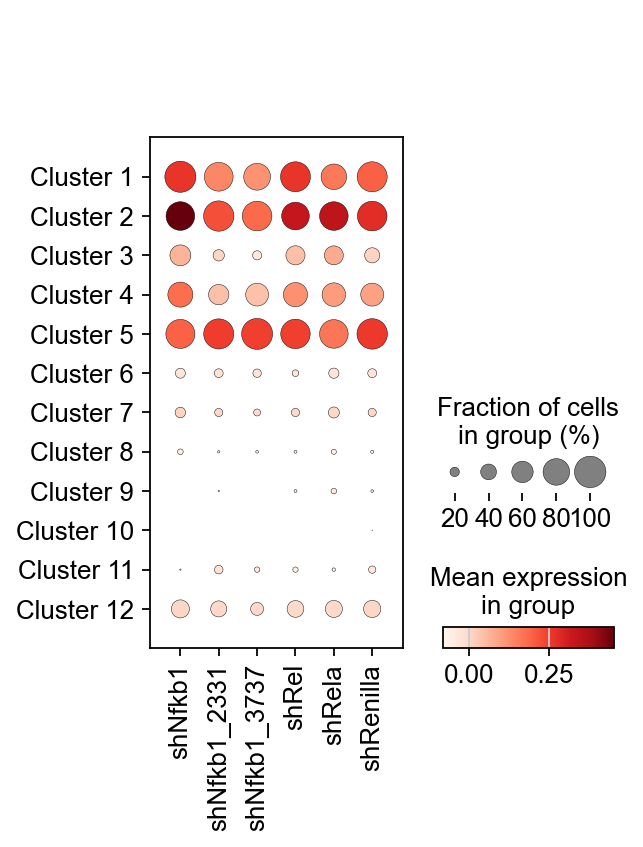

In [153]:
(clusters, clusterkeys, HPCS) = resetClusters('cell2020')
scoreAndPlot(adata3, groupby='Group',numgenes=100)

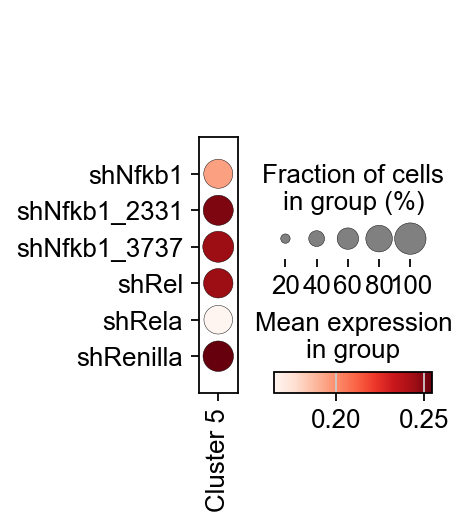

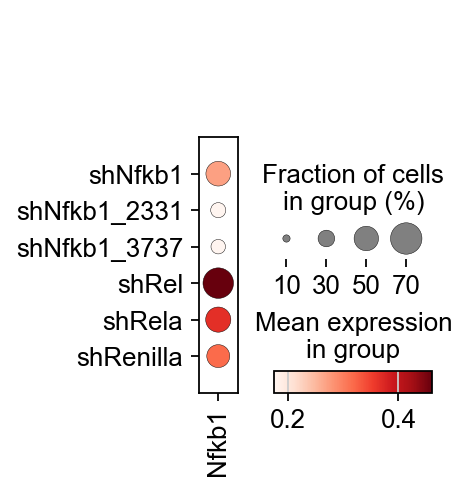

In [154]:
sc.pl.dotplot(adata3, ['Cluster 5'], groupby='Group')
sc.pl.dotplot(adata3, ['Nfkb1'], groupby='Group') #,'Slc4a11'

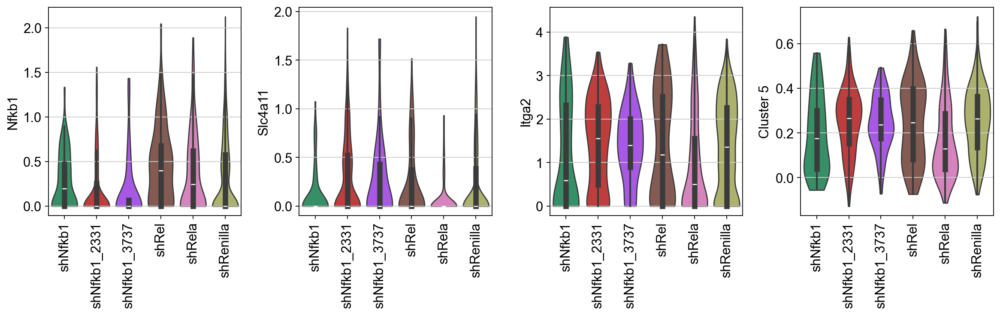

In [155]:
sc.pl.violin(adata3,['Nfkb1','Slc4a11','Itga2','Cluster 5'], groupby='Group',inner='box',stripplot=False, rotation=90)

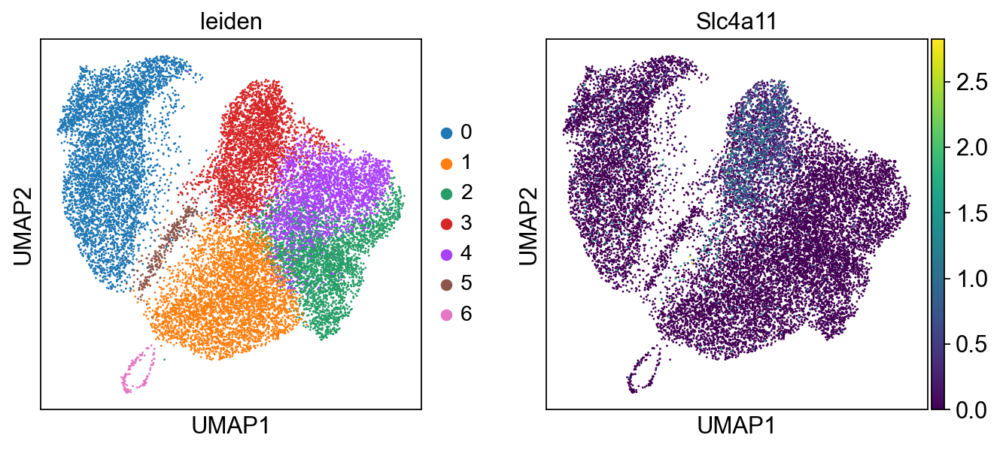

In [156]:
sc.pl.umap(adata, color=['leiden','Slc4a11'])

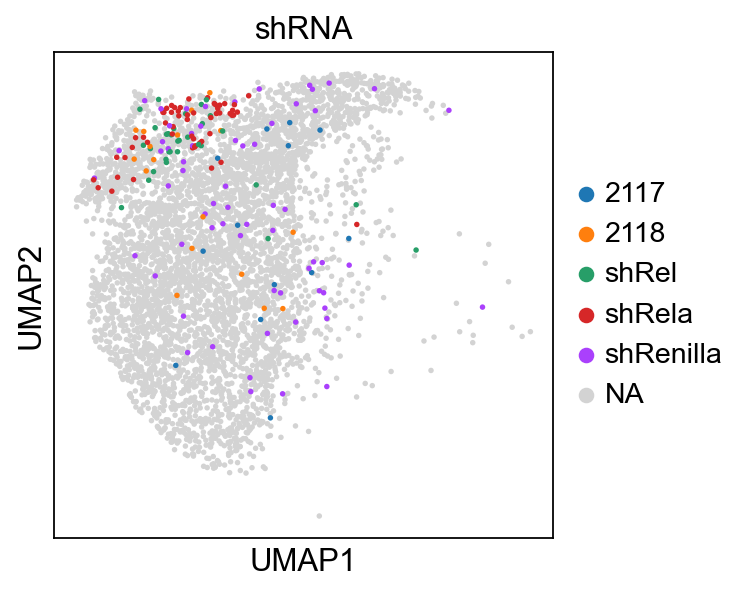

In [157]:
sc.pl.umap(adata[adata.obs.leiden.isin(['0']),:], color=['shRNA'])

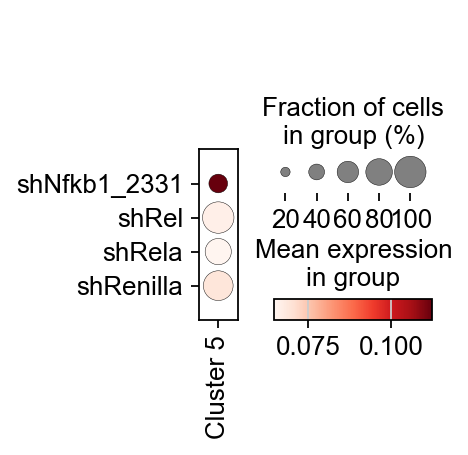

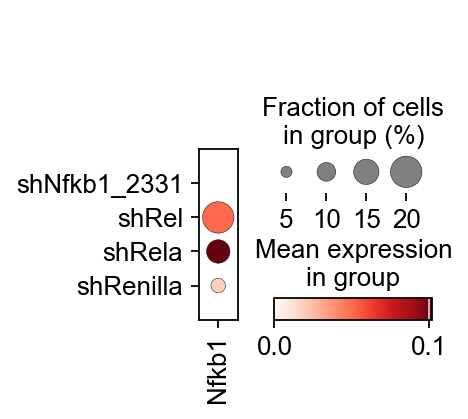

ERROR: Please check that the categories given by the `order` parameter match the categories that want to be reordered.

Mismatch: {'shRenilla', 'shRela', 'shRel', 'shNfkb1_2331'}

Given order categories: ['Renilla_Control', '2118_Control', '2117_Control']

Group categories: ['shNfkb1_2331', 'shRel', 'shRela', 'shRenilla']



KeyError: "None of [Index(['Renilla_Control', '2118_Control', '2117_Control'], dtype='object', name='Group')] are in the [index]"

In [158]:
sc.pl.dotplot(adata3[adata3.obs.leiden.isin(['0']),:], ['Cluster 5'], groupby='Group')
sc.pl.dotplot(adata3[adata3.obs.leiden.isin(['0']),:], ['Nfkb1'], groupby='Group') #,'Slc4a11'
sc.pl.dotplot(adata3[adata3.obs.leiden.isin(['0']),:], ['Nfkb1'], groupby='Group', 
              swap_axes=True, categories_order=['Renilla_Control','2118_Control',
                                                                        '2117_Control']) #,'Slc4a11' save='Nfkb1_dotplot.svg',

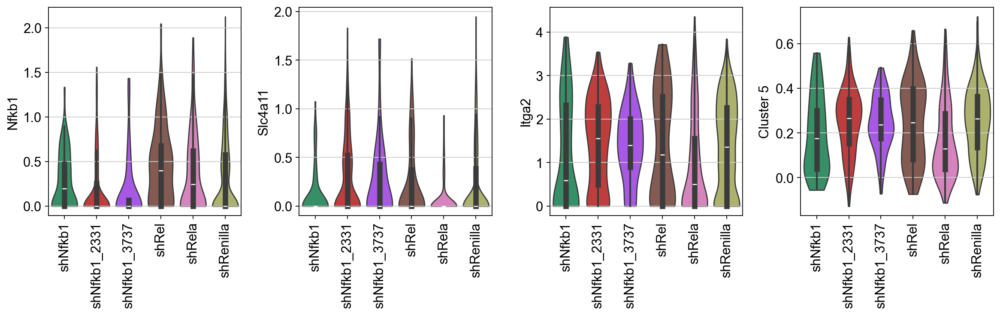

In [159]:
sc.pl.violin(adata3,['Nfkb1','Slc4a11','Itga2','Cluster 5'], groupby='Group',inner='box',stripplot=False, rotation=90)

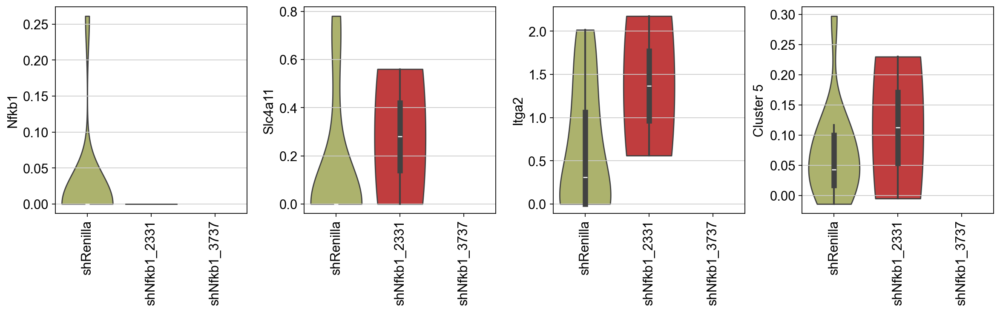

In [165]:
sc.pl.violin(adata3[adata3.obs.leiden.isin(['0']),:],['Nfkb1','Slc4a11','Itga2','Cluster 5'], 
             groupby='Group',inner='box',stripplot=False, rotation=90,order=['shRenilla',
                                                                            'shNfkb1_2331','shNfkb1_3737',]) #,save='violin_plot_gfp_leiden0.svg')

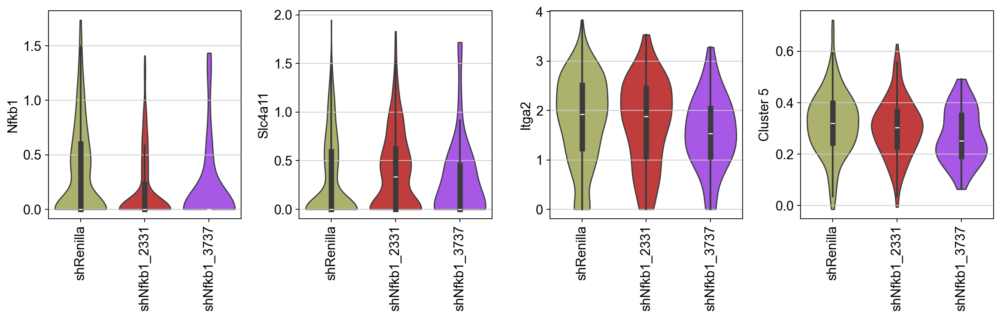

In [166]:
sc.pl.violin(adata3[adata3.obs.clusterK12.isin(['05']),:],['Nfkb1','Slc4a11','Itga2','Cluster 5'], 
             groupby='Group',inner='box',stripplot=False, rotation=90,order=['shRenilla',
                                                                            'shNfkb1_2331','shNfkb1_3737',])#,save='violin_plot_gfp_cluster5.svg')

In [167]:
sc.tl.embedding_density(adata3, basis='umap', groupby='Group')

computing density on 'umap'
--> added
    'umap_density_Group', densities (adata.obs)
    'umap_density_Group_params', parameter (adata.uns)


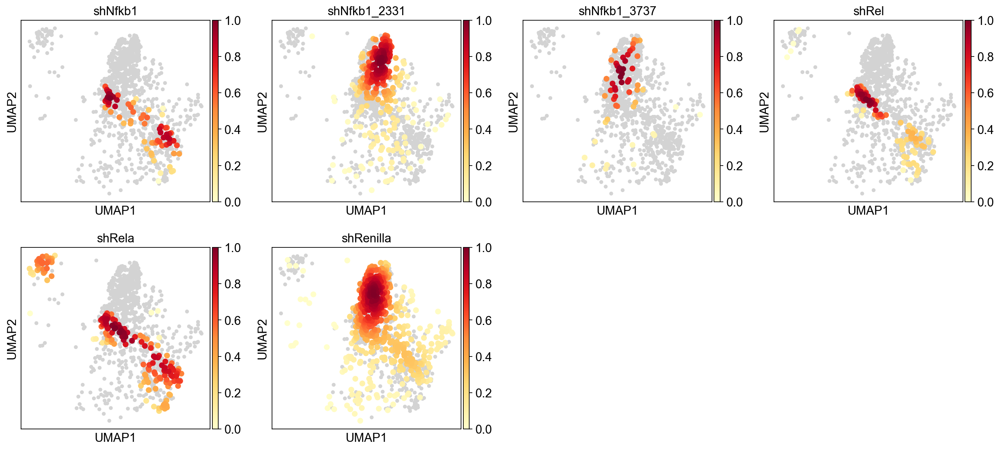

In [168]:
sc.pl.embedding_density(adata3, basis='umap', key='umap_density_Group')

In [177]:
import scipy.stats
scipy.stats.mannwhitneyu(adata3[adata3.obs.clusterK12.isin(['05']) & adata3.obs.Group.isin(['shRenilla']),:].obs['Cluster 5'], 
                   adata3[adata3.obs.clusterK12.isin(['05']) & adata3.obs.Group.isin(['shNfkb1.3737']),:].obs['Cluster 5'], )

/tmp/ipykernel_3157407/2037239694.py:2: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  scipy.stats.mannwhitneyu(adata3[adata3.obs.clusterK12.isin(['05']) & adata3.obs.Group.isin(['shRenilla']),:].obs['Cluster 5'],


MannwhitneyuResult(statistic=np.float64(nan), pvalue=np.float64(nan))

In [172]:
import scipy.stats
scipy.stats.mannwhitneyu(adata3[adata3.obs.clusterK12.isin(['05']) & adata3.obs.Group.isin(['Renilla_Control']),:].obs['Cluster 5'], 
                   adata3[adata3.obs.clusterK12.isin(['05']) & adata3.obs.Group.isin(['2117_Control']),:].obs['Cluster 5'], )

/tmp/ipykernel_3157407/2728143201.py:2: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  scipy.stats.mannwhitneyu(adata3[adata3.obs.clusterK12.isin(['05']) & adata3.obs.Group.isin(['Renilla_Control']),:].obs['Cluster 5'],


MannwhitneyuResult(statistic=np.float64(nan), pvalue=np.float64(nan))

In [173]:
sc.tl.rank_genes_groups(adata3, 'Group', method='wilcoxon', reference='Renilla_Control')
sc.pl.rank_genes_groups(adata3, n_genes=25, sharey=False)

ranking genes


ValueError: reference = Renilla_Control needs to be one of groupby = ['shNfkb1', 'shNfkb1_2331', 'shNfkb1_3737', 'shRel', 'shRela', 'shRenilla'].

In [174]:
#pd.DataFrame(adata3.uns['rank_genes_groups']['names']).to_excel('write/controlGFPCellsvsRenilla.xlsx')
pd.DataFrame(adata3.uns['rank_genes_groups']['names']).head(50)

KeyError: 'rank_genes_groups'

In [175]:
top2117 = (pd.DataFrame(adata3.uns['rank_genes_groups']['names']['2117_Control']).head(50)).to_numpy().flatten()
top2118 = (pd.DataFrame(adata3.uns['rank_genes_groups']['names']['2118_Control']).head(50)).to_numpy().flatten()
#saline_rev = (pd.DataFrame(adata3.uns['rank_genes_groups']['names']['Renilla_Control']).tail(50)).to_numpy().flatten()
#saline_rev = list(saline_rev)
#saline_rev.reverse()

KeyError: 'rank_genes_groups'

In [ ]:
sc.tl.rank_genes_groups(adata3, 'Group', method='wilcoxon')
sc.pl.rank_genes_groups(adata3, n_genes=25, sharey=False)

In [ ]:
sc.pl.rank_genes_groups_dotplot(adata3,groupby='Group',values_to_plot='logfoldchanges', 
                                cmap='bwr', var_names=top2117[1:21])

In [ ]:
sc.pl.rank_genes_groups_dotplot(adata3,groupby='Group',values_to_plot='logfoldchanges', 
                                cmap='bwr', var_names=top2118[1:21])

## Test

In [ ]:
adata5 = adata_controls.raw.to_adata()[adata_controls[adata_controls.obs.leiden.isin(['1']),:].obs.index,:]

In [ ]:
adata5

In [ ]:
sc.pp.highly_variable_genes(adata5, batch_key='batch')

In [ ]:
adata5.var.index

In [ ]:
adata5.var.highly_variable_intersection['mKate2'] = False
adata5.var.highly_variable_intersection['GFP'] = False
adata5.var.highly_variable_intersection['Cre'] = False
for x in library:
    adata5.var.highly_variable_intersection[x] = False

In [ ]:
sc.pl.highly_variable_genes(adata5)

In [ ]:
adata5 = adata5[:,adata5.var.highly_variable_intersection]

In [ ]:
sc.pp.regress_out(adata5, ['total_counts', 'pct_counts_mt'])

In [ ]:
sc.pp.scale(adata5, max_value=10)

In [ ]:
sc.tl.pca(adata5, svd_solver='arpack', n_comps=150)

In [ ]:
sc.pl.pca(adata, color='Snhg6')

In [ ]:
sc.pl.pca_variance_ratio(adata5, log=True,n_pcs=150)

In [ ]:
sc.pp.neighbors(adata5, n_neighbors=15, n_pcs=50)

In [ ]:
sc.tl.umap(adata5)

In [ ]:
sc.pl.umap(adata5, color=['batch', 'Classification'])
sc.pl.umap(adata5, color=['Group'])#'shRNA'
sc.pl.umap(adata5, color=['shRNA'],save='shRNA_umap.svg')#

In [ ]:
sc.pl.umap(adata5[adata5.obs.batch.isin(['lane1']),:], color=['batch', 'Classification'])
sc.pl.umap(adata5[adata5.obs.batch.isin(['lane1']),:], color=['Group'])#'shRNA'

In [ ]:
sc.pl.umap(adata5[adata5.obs.batch.isin(['lane2']),:], color=['batch', 'Classification'])
sc.pl.umap(adata5[adata5.obs.batch.isin(['lane2']),:], color=['Group'])#'shRNA'

In [ ]:
adata5

In [ ]:
(clusters, clusterkeys, HPCS) = resetClusters('cell2020')
scoreAndPlot(adata5, groupby='Group',numgenes=500)

In [ ]:
(clusters, clusterkeys, HPCS) = resetClusters('cl5bootstrap2')
scoreAndPlot(adata5,numgenes=100, groupby='Group')